In this notebook, we want to see how to apply transformations — even on levels with a higher resolution than the ones we trained on.

# Imports and functions

## Imports

In [1]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

plt.plot() # if we don't do that here, plt won't work normally from here on out

matplotlib.use('agg')

In our case, the block above throws a "bad key" warning. We decided not to worry about it.

In [2]:
import sys
sys.path.append('../wsi_processing_pipeline')
sys.path.append('../wsi_processing_pipeline/tile_extraction')
sys.path.append('/opt/conda/lib/python3.9/site-packages')

In [3]:
from PIL import Image, ImageDraw
import slide

import ipywidgets as widgets
from IPython.display import display, clear_output


%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [4]:
from ipywidgets import interact, fixed

In [6]:
def display_n_2d_arrays(imagelist, fig_size=None, cmap=[], titles=[]):
    n = len(imagelist)
    if len(cmap) != n:
        cmap = n*[None]
    if len(titles) != n:
        titles = n*['']
    if fig_size == None:
        fig_size = ((int)(n*5),8)
    plt.subplots(1,n,figsize=fig_size)
    
    for i in range(n):
        plt.subplot(1,n,i+1)
        plt.imshow(imagelist[i], cmap[i], vmin=0, vmax=255)
        plt.axis('off')
        plt.title(titles[i])
    
    plt.show()

In [7]:
# ! pip install SimpleITK

In [8]:
import SimpleITK as sitk
print(sitk.Version())
# if problems occur, see Notebook 3

SimpleITK Version: 2.3.0 (ITK 5.3)
Compiled: Sep 12 2023 18:43:59



In [9]:
def color_transform(input_pil, transformation):
    red, green, blue, alpha = input_pil.split()
    
    red_sitk = sitk.GetImageFromArray(red)
    green_sitk = sitk.GetImageFromArray(green)
    blue_sitk = sitk.GetImageFromArray(blue)
    alpha_sitk = sitk.GetImageFromArray(alpha)
    
    red_tfmd = sitk.Resample(red_sitk, transformation, sitk.sitkLinear, 0.0, red_sitk.GetPixelID())
    green_tfmd = sitk.Resample(green_sitk, transformation, sitk.sitkLinear, 0.0, green_sitk.GetPixelID())
    blue_tfmd = sitk.Resample(blue_sitk, transformation, sitk.sitkLinear, 0.0, blue_sitk.GetPixelID())
    alpha_tfmd = sitk.Resample(alpha_sitk, transformation, sitk.sitkLinear, 0.0, alpha_sitk.GetPixelID())
    
    return Image.merge("RGBA", (Image.fromarray(sitk.GetArrayViewFromImage(red_tfmd)),
                                Image.fromarray(sitk.GetArrayViewFromImage(green_tfmd)),
                                Image.fromarray(sitk.GetArrayViewFromImage(blue_tfmd)),
                                Image.fromarray(sitk.GetArrayViewFromImage(alpha_tfmd))))

In [10]:
def get_full_transform(pair):
    aff_tfm = sitk.ReadTransform(pair["aff path"])
    bsp_tfm = sitk.ReadTransform(pair["bsp path"])
    return sitk.CompositeTransform([aff_tfm, bsp_tfm])

In [11]:
def get_tfm_dims(pair):
    transform_dimensions = sitk.BSplineTransform(sitk.ReadTransform(pair["bsp path"])).GetTransformDomainPhysicalDimensions()
    return ((int)(transform_dimensions[0]), (int)(transform_dimensions[1]))

In [12]:
import pathlib
from pathlib import Path
output_path = Path('Output')

import pandas as pd
pair_df = pd.read_csv(output_path/'pairlist_df_3.csv')

# Transform larger WSI

## The problem and the solution

In [13]:
index = 5
pair = pair_df.iloc[[index]].squeeze()

In [14]:
pair

(classified)


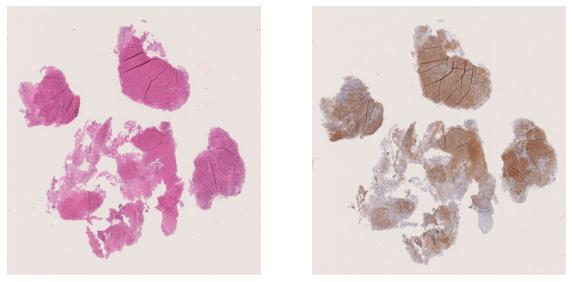

In [15]:
ihc_slide = slide.open_slide(pair["ihc path"])
he_slide = slide.open_slide(pair["he path"])
he_pic_lv7 = he_slide.read_region((0,0),
                             7,
                             he_slide.level_dimensions[7])
ihc_pic_lv7 = ihc_slide.read_region((0,0),
                                 7,
                                 ihc_slide.level_dimensions[7])
display_n_2d_arrays([he_pic_lv7, ihc_pic_lv7])

Applying our previously generated transformation to this IHC WSI image gives us our expected result:

In [16]:
ihc_tfmd_lv7 = color_transform(ihc_pic_lv7, get_full_transform(pair))

In [17]:
def displayAlternating(imArr, whichone):
    display_n_2d_arrays([imArr[whichone]], cmap=['gray'])
        
displayArr = [he_pic_lv7,
              ihc_tfmd_lv7.crop((0,0,he_pic_lv7.size[0],he_pic_lv7.size[1])),
              ihc_pic_lv7.crop((0,0,he_pic_lv7.size[0],he_pic_lv7.size[1]))]
interact(displayAlternating,
         imArr =  fixed(displayArr),
         whichone = (0,len(displayArr)-1,1))

interactive(children=(IntSlider(value=1, description='whichone', max=2), Output()), _dom_classes=('widget-inte…

<function __main__.displayAlternating(imArr, whichone)>

However, when we try to transform WSIs, we realize that SITK's transforms don't scale automatically:

In [18]:
he_pic_lv6 = he_slide.read_region((0,0),
                             6,
                             he_slide.level_dimensions[6])
ihc_pic_lv6 = ihc_slide.read_region((0,0),
                                 6,
                                 ihc_slide.level_dimensions[6])
ihc_tfmd_lv6 = color_transform(ihc_pic_lv6, get_full_transform(pair))
displayArr = [he_pic_lv6,
              ihc_tfmd_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1])),
              ihc_pic_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1]))]
interact(displayAlternating,
         imArr =  fixed(displayArr),
         whichone = (0,len(displayArr)-1,1))

interactive(children=(IntSlider(value=1, description='whichone', max=2), Output()), _dom_classes=('widget-inte…

<function __main__.displayAlternating(imArr, whichone)>

The solution is scaling the image down by the desired factor first, then apply the transformation, and then scale back up.

**Please note**: It is necessary to **not** save the image inbetween steps, but to instead apply all transformations at once. Otherwise, the resolution of the resulting image will have scaled down.

In our case, the desired factor is `2`: The transformation was trained on level 7, we now operate on level 6 (which is twice as big in both width and height)

In [19]:
transform_dimensions = sitk.BSplineTransform(sitk.ReadTransform(pair["bsp path"])).GetTransformDomainPhysicalDimensions()
((int)(transform_dimensions[0]), (int)(transform_dimensions[1]))

(952, 1008)

In [20]:
ihc_tfmd_lv7.size

(476, 504)

In [21]:
ihc_tfmd_lv6.size

(952, 1008)

In [22]:
he_pic_lv6.size

(952, 1008)

Note that `transform_dimensions` *looks* like it had been registered on level 6, and that the reason for that is that we duplicated the maximum image dimensions before registration, as a safety margin.

In [23]:
preScale = sitk.ScaleTransform(2, (2,2))
reScale = sitk.ScaleTransform(2, (0.5,0.5))
# the wrong way:
ihc_tfmd_lv6_bad = color_transform(color_transform(color_transform(ihc_pic_lv6,
                                                                    preScale),
                                                    get_full_transform(pair)),
                                    reScale)
#the right way:
ihc_tfmd_lv6_good = color_transform(ihc_pic_lv6, sitk.CompositeTransform([preScale, get_full_transform(pair), reScale]))

In [24]:
displayArr = [he_pic_lv6,
              ihc_tfmd_lv6_good.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1])),
              ihc_tfmd_lv6_bad.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1]))]
interact(displayAlternating,
         imArr =  fixed(displayArr),
         whichone = (0,len(displayArr)-1,1))

interactive(children=(IntSlider(value=1, description='whichone', max=2), Output()), _dom_classes=('widget-inte…

<function __main__.displayAlternating(imArr, whichone)>

In [25]:
ihc_tfmd_lv6_good.size

(952, 1008)

In [26]:
ihc_tfmd_lv6_bad.size

(952, 1008)

The difference is already visible, but it gets even more apparent when we zoom in:

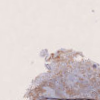

In [27]:
#after
ihc_tfmd_lv6_good.crop((100,175,200,275))

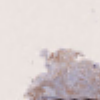

In [28]:
#after, but worse
ihc_tfmd_lv6_bad.crop((100,175,200,275))

And the HE image, as a comparison:

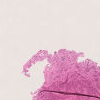

In [29]:
he_pic_lv6.crop((100,175,200,275))

## The same cells for level 5 (4x scaling)

In [30]:
he_pic_lv5 = he_slide.read_region((0,0),
                             5,
                             he_slide.level_dimensions[5])
ihc_pic_lv5 = ihc_slide.read_region((0,0),
                                 5,
                                 ihc_slide.level_dimensions[5])

ihc_tfmd_lv5 = color_transform(ihc_pic_lv5, get_full_transform(pair))

In this case, the desired factor is `4`: The transformation was trained on level 7, we now operate on level 5 (which is 2^2 as big in both width and height)

In [31]:
transform_dimensions = sitk.BSplineTransform(sitk.ReadTransform(pair["bsp path"])).GetTransformDomainPhysicalDimensions()
((int)(transform_dimensions[0]), (int)(transform_dimensions[1]))

(952, 1008)

In [32]:
he_pic_lv6.size

(952, 1008)

In [33]:
ihc_pic_lv5.size

(1904, 2016)

Note that `transform_dimensions` *looks* like it had been registered on level 6, but that the reason is that we duplicated the image dimensions before registration, as a safety margin.

In [34]:
preScale = sitk.ScaleTransform(2, (4,4))
reScale = sitk.ScaleTransform(2, (0.25,0.25))
# the wrong way:
ihc_tfmd_lv5_bad = color_transform(
                                        color_transform(
                                            color_transform(ihc_pic_lv5, preScale),
                                            get_full_transform(pair)
                                        ),
                                        reScale
                                    )
#the right way:
ihc_tfmd_lv5_good = color_transform(ihc_pic_lv5, sitk.CompositeTransform([preScale, get_full_transform(pair), reScale]))

In [35]:
displayArr = [he_pic_lv5,
              ihc_tfmd_lv5_good.crop((0,0,he_pic_lv5.size[0],he_pic_lv5.size[1])),
              ihc_tfmd_lv5_bad.crop((0,0,he_pic_lv5.size[0],he_pic_lv5.size[1]))]
interact(displayAlternating,
         imArr =  fixed(displayArr),
         whichone = (0,len(displayArr)-1,1))

interactive(children=(IntSlider(value=1, description='whichone', max=2), Output()), _dom_classes=('widget-inte…

<function __main__.displayAlternating(imArr, whichone)>

The difference is already visible, but it gets even more apparent when we zoom in:

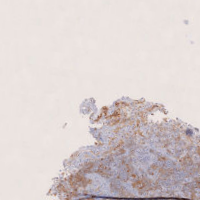

In [36]:
#after
ihc_tfmd_lv5_good.crop((200,350,400,550))

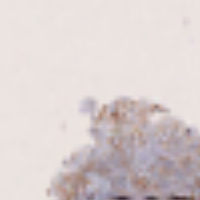

In [37]:
#after, but worse
ihc_tfmd_lv5_bad.crop((200,350,400,550))

And the HE image, as a comparison:

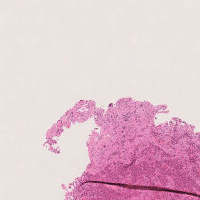

In [38]:
he_pic_lv5.crop((200,350,400,550))

## Demonstration of the problem for the paper

In [39]:
def chessimg_rec(w, h, sqrw = None, sqrh = None):
    # Create new black image of entire board
    img = Image.new("L", (w,h))
    pixels = img.load()

    # Make square tiles unless specified otherwise
    if sqrw == None and sqrh == None:
        sqrw = w/20
        sqrh = sqrw
    
    # Make pixels white where (row+col) is odd
    for i in range(w):
        for j in range(h):
            if ((int)(i/sqrw)+(int)(j/sqrh))%2:
                pixels[i,j] = 255
    return img

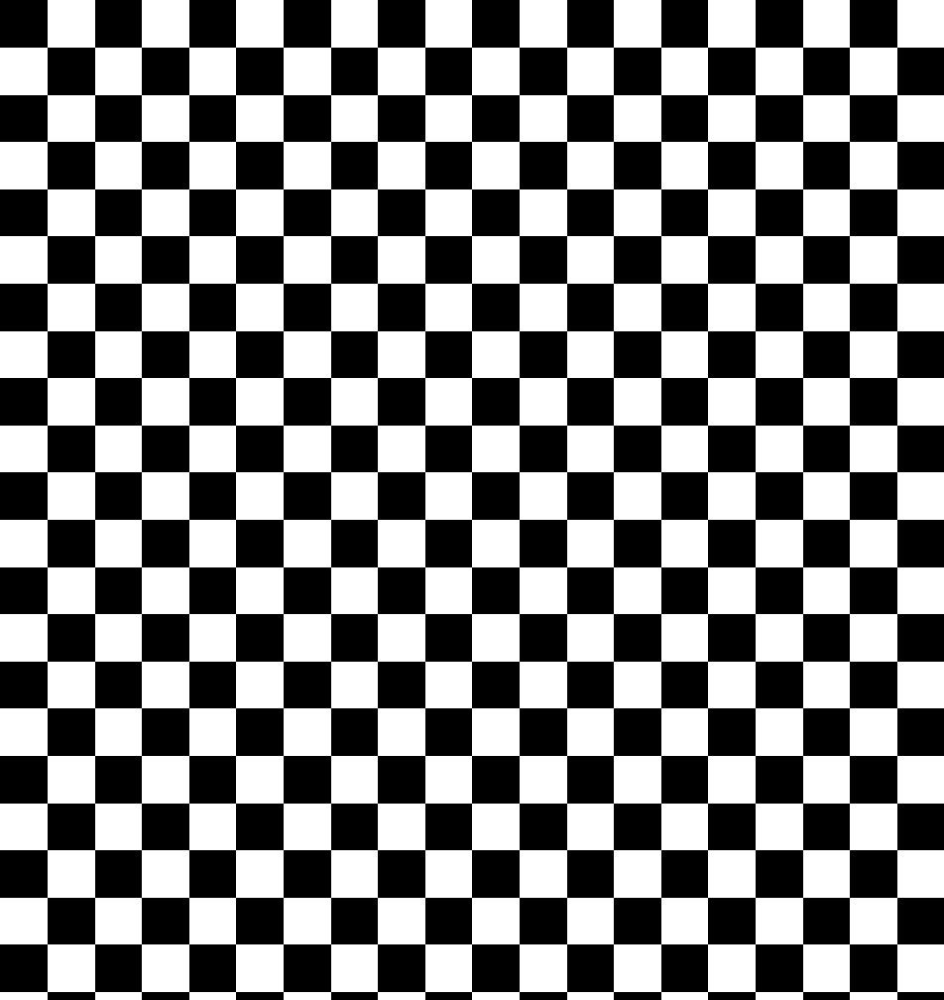

In [40]:
width = (int)(transform_dimensions[0])
height = (int)(transform_dimensions[1])
chess_lv6 = chessimg_rec(width,
                         height
                         ).convert('RGBA')
chess_lv6

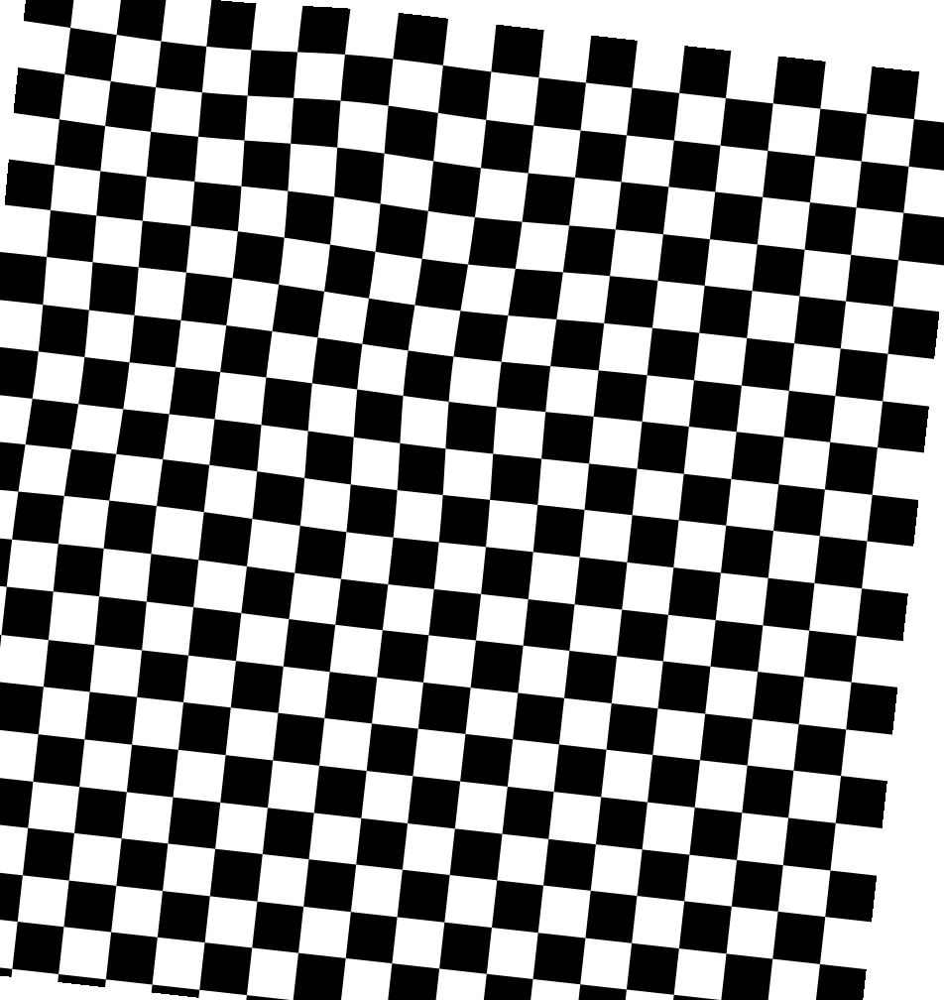

In [41]:
# the wrongest way:
chess_tfmd_lv6_worst = color_transform(chess_lv6, get_full_transform(pair))
chess_tfmd_lv6_worst

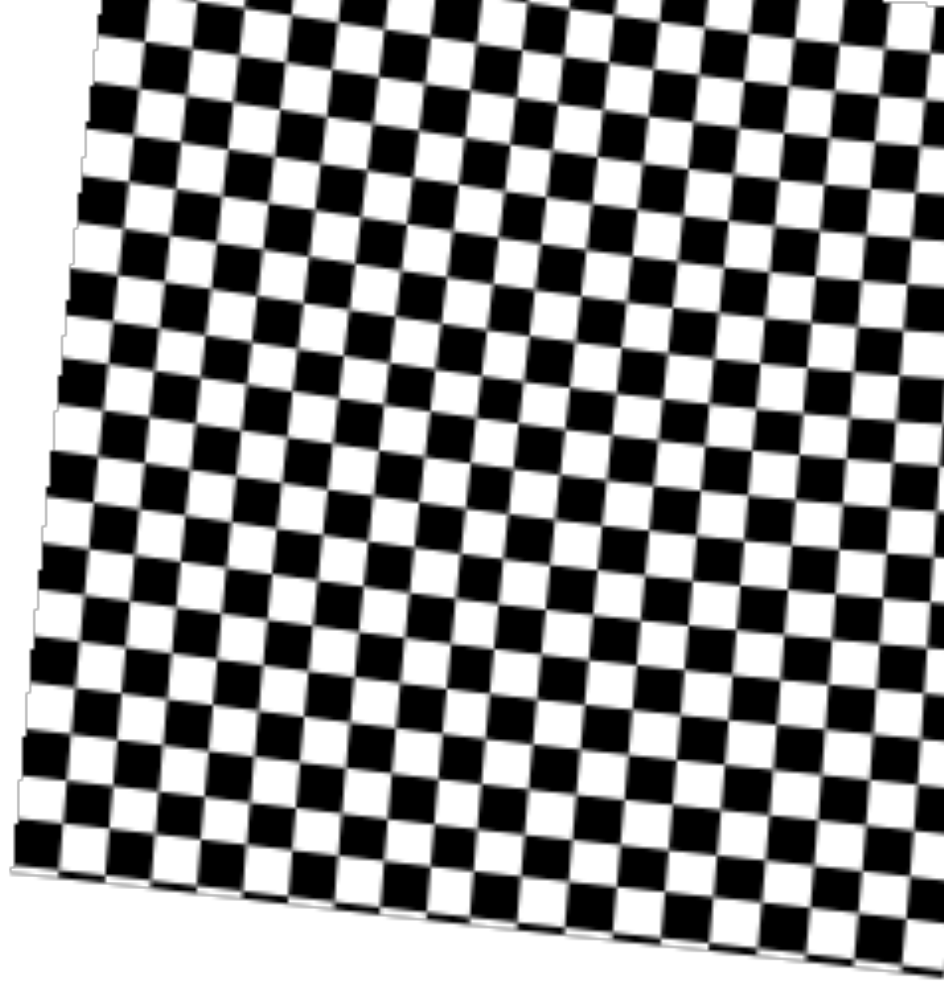

In [42]:
# the less wrong but still wrong way:
chess_tfmd_lv6_bad = color_transform(color_transform(color_transform(chess_lv6,
                                                                    preScale),
                                                    get_full_transform(pair)),
                                    reScale)
chess_tfmd_lv6_bad

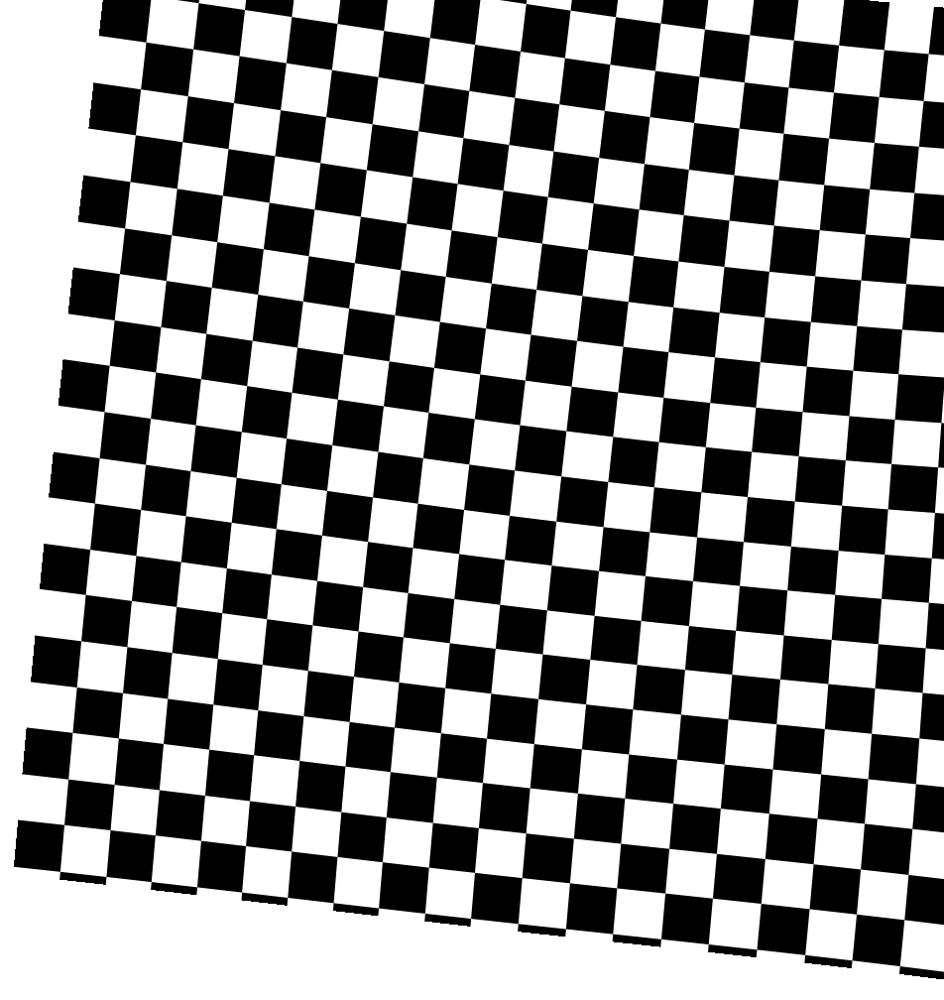

In [43]:
#the right way:
chess_tfmd_lv6_good = color_transform(chess_lv6, sitk.CompositeTransform([preScale, get_full_transform(pair), reScale]))
chess_tfmd_lv6_good

# Tile-wise

## Outlining the problem

In our case, it was desirable to extract tiles of a certain size (e.g., 512*512 pixels) for later CNN training.

For the extraction of single tiles, reading the whole WSI into memory would consume too much time and memory to be practicable. Furthermore, our working memory sometimes failed at this task, running out of memory altogether.

To extract **and** transform tiles under these circumstances, a series of transformations had to be performed, which will be explained in this section.

First of, let's look at an exemplary tile in our HE (i.e., fixed) image, on highest resolution.

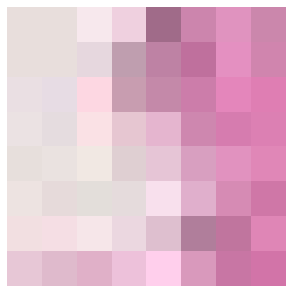

In [44]:
# finding a good tile in low res
x = 478
display_n_2d_arrays([he_pic_lv6.crop((x,x,x+8,x+8))])

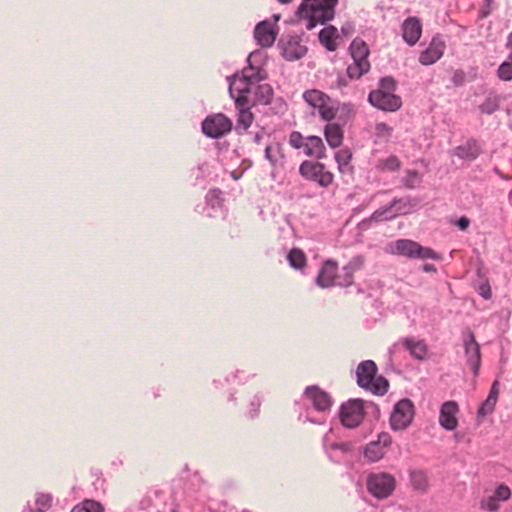

In [45]:
he_tile_lv0 = he_slide.read_region((x*2**6, x*2**6),
                             0,
                             (512, 512))
he_tile_lv0

For reference, this tile is located in the bright square in the following WSI:

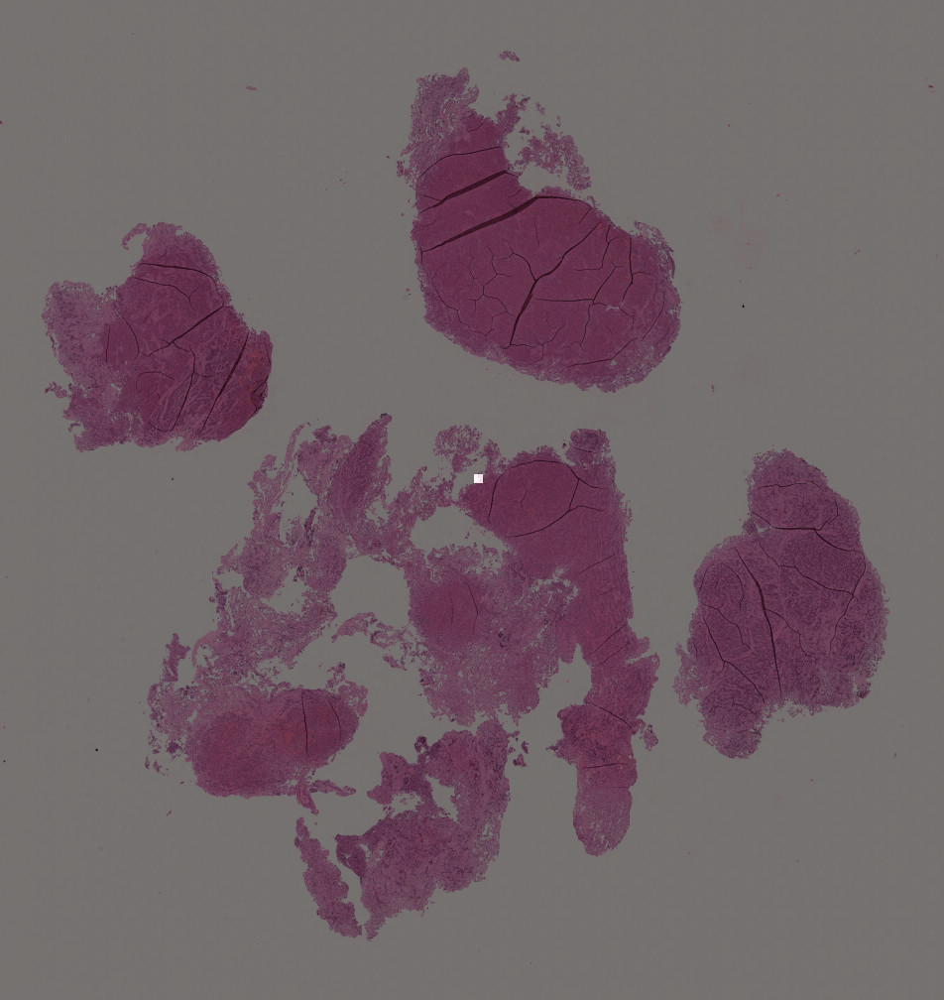

In [46]:
overlayim = Image.new("RGB", he_pic_lv6.size).convert("RGBA")
draw = ImageDraw.Draw(overlayim)
draw.rectangle((x,x,x+8,x+8), fill=(255,255,255,0), outline=None, width=1)
Image.blend(he_pic_lv6, overlayim, 0.5)

Now, to match this square, we want to extract as little data as possible from the IHC WSI:

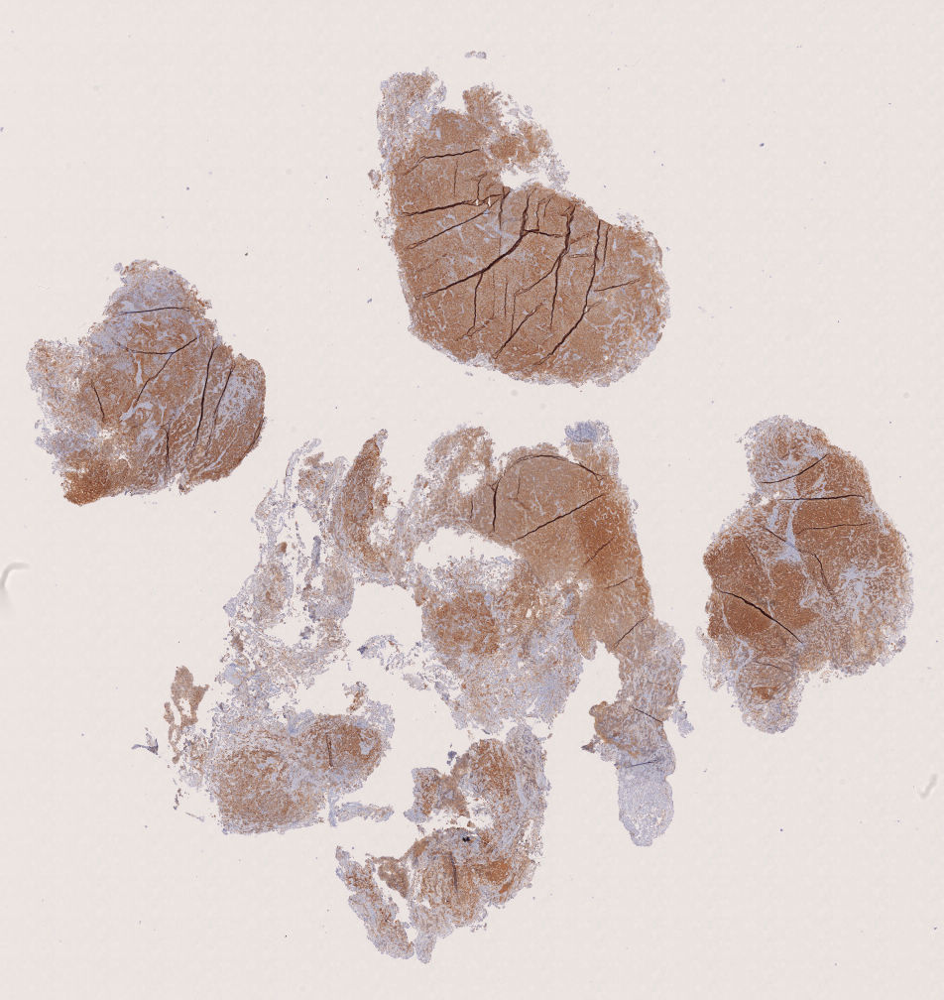

In [47]:
ihc_pic_lv6

## Calculating the target area

There's a better approach which will be outlined here:

Instead of transforming many pixels, which is time-intensive and requires the processing of much redundant information, we will just transform four points: The corners of the target square. We will do that first and then explain why this approach works just as well.

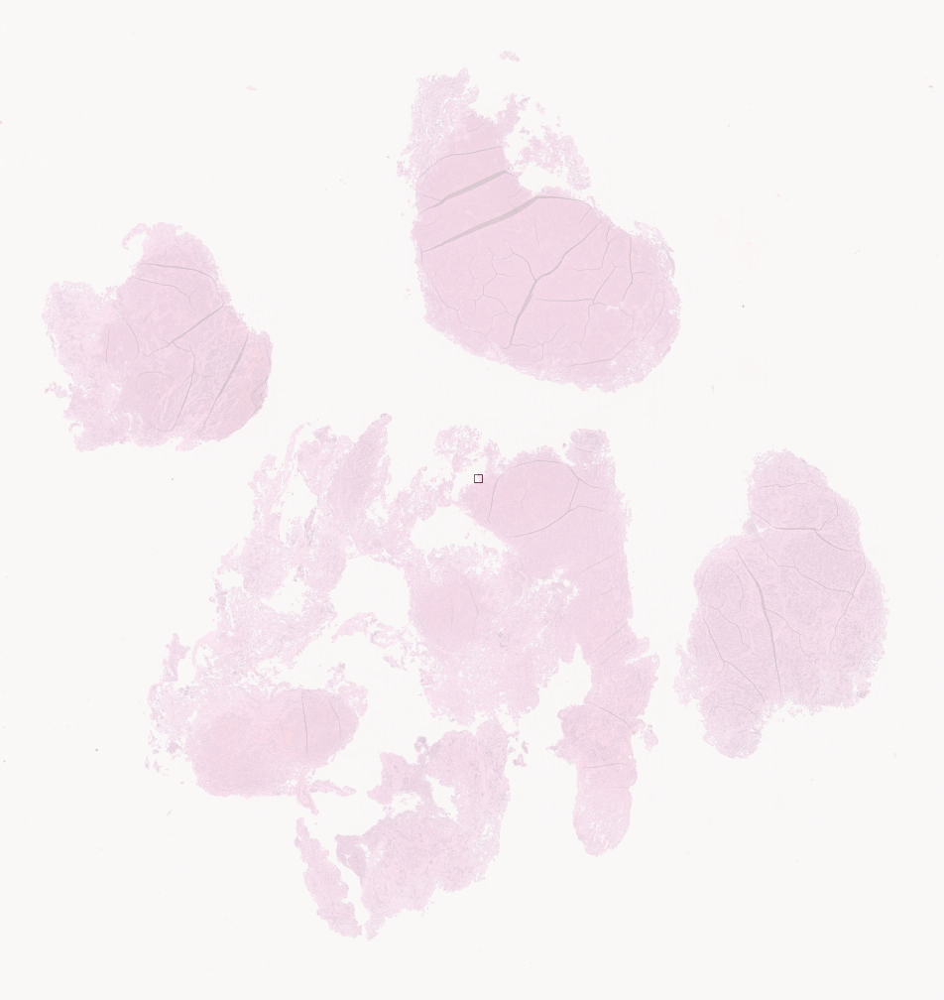

In [48]:
# coordinates of the corners
ul = (x,x) # upper left
ur = (x+8,x) # upper right
ll = (x,x+8) # lower left
lr = (x+8,x+8) # lower right

overlayim2 = Image.new("RGBA", he_pic_lv6.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim2)
draw.line(ul+ur, fill=(0,0,0,255), width=1)
draw.line(ur+lr, fill=(0,0,0,255), width=1)
draw.line(lr+ll, fill=(0,0,0,255), width=1)
draw.line(ll+ul, fill=(0,0,0,255), width=1)
Image.blend(he_pic_lv6, overlayim2, 0.5)

Here it is in the fully transformed IHC WSI:

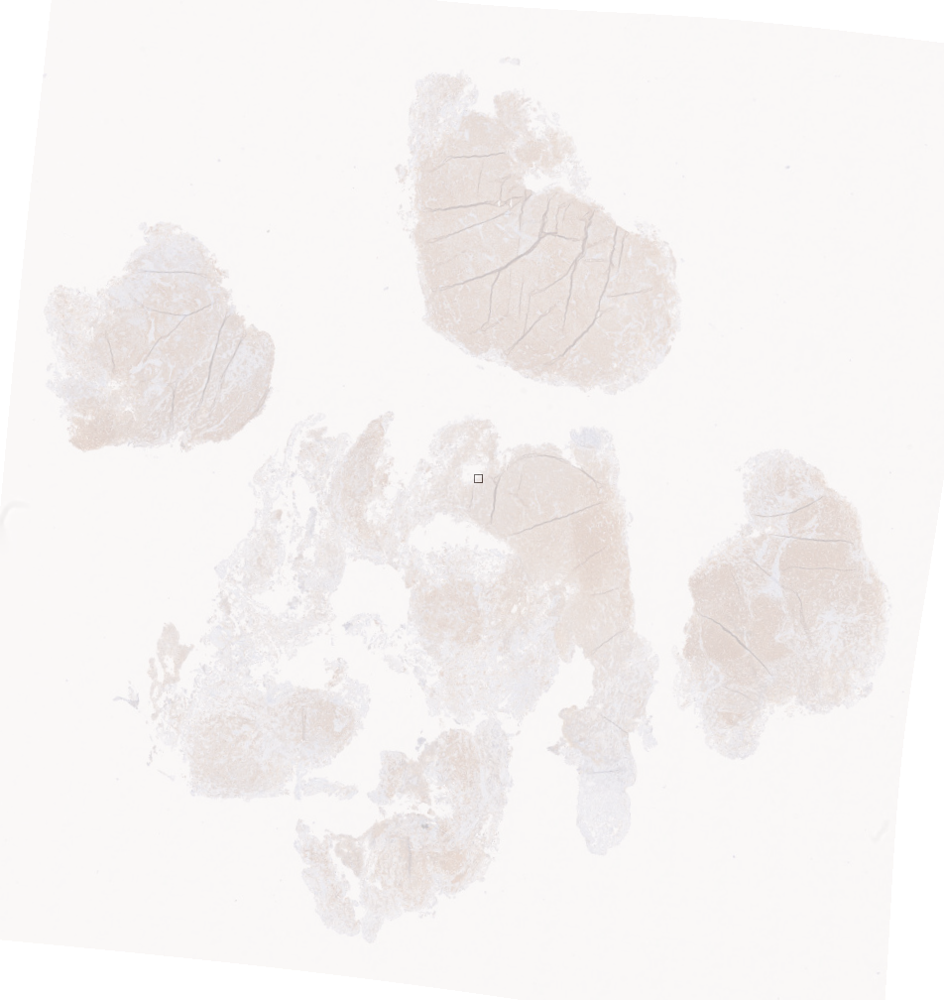

In [49]:
Image.blend(ihc_tfmd_lv6_good, overlayim2, 0.5)

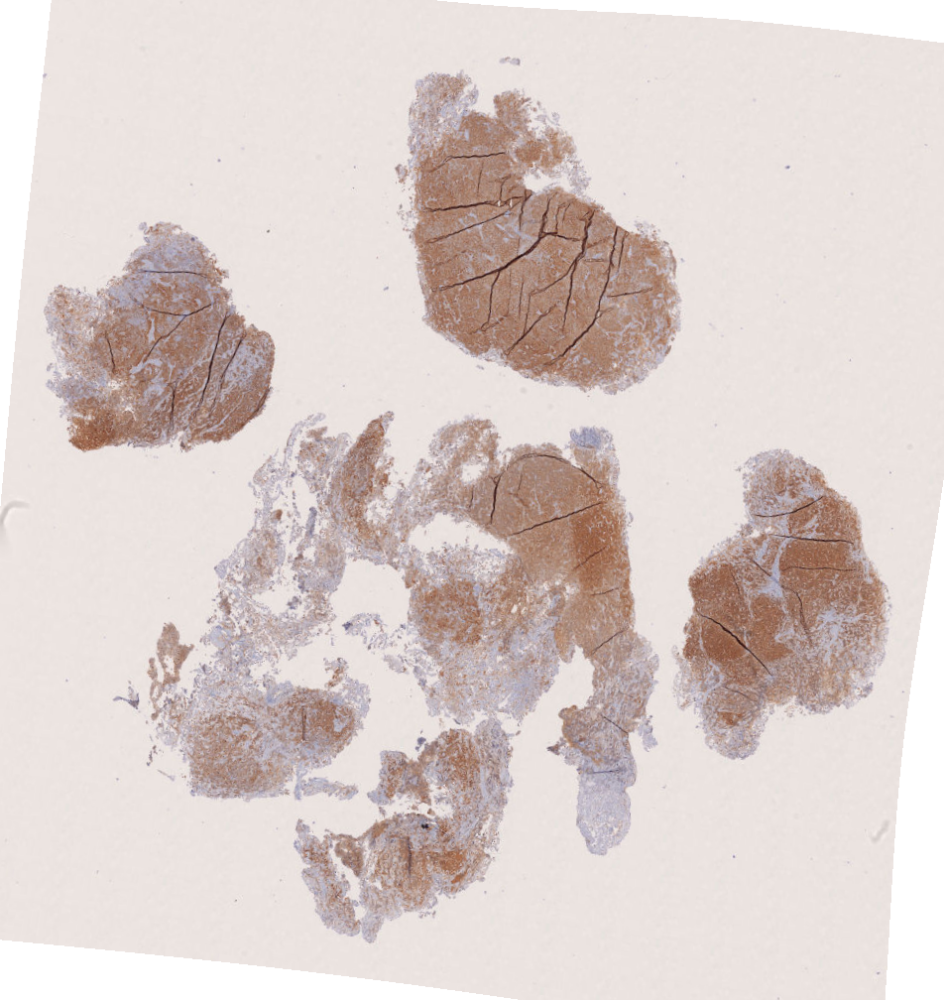

In [50]:
ihc_tfmd_lv6_good

As an intermediary step, let's look at the same area inbetween the affine and the BSpline transformation. For that, we inverse transform the corner points:

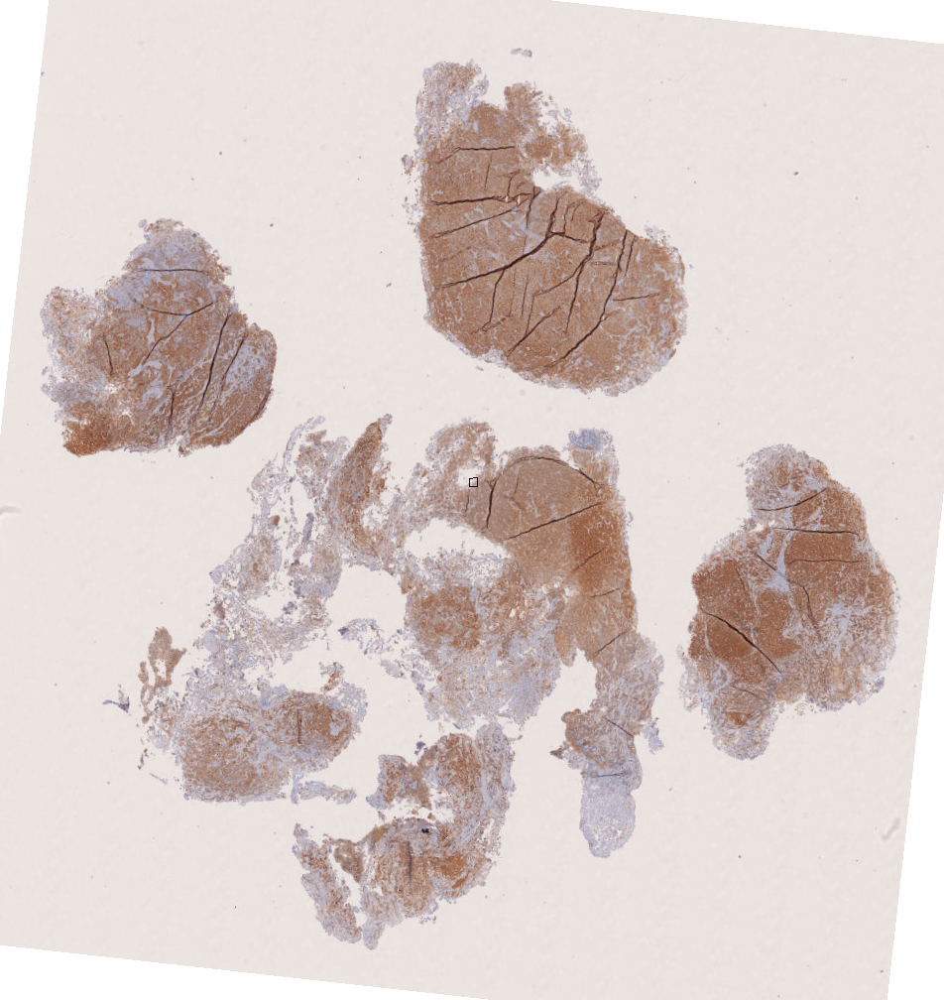

In [51]:
bsp_tfm = sitk.ReadTransform(pair["bsp path"])
aff_tfm = sitk.ReadTransform(pair["aff path"])
preScale = sitk.ScaleTransform(2, (2,2))
reScale = sitk.ScaleTransform(2, (0.5,0.5))
bsp_with_scale = sitk.CompositeTransform([preScale, bsp_tfm, reScale])
ul_1 = bsp_with_scale.TransformPoint(ul)
ur_1 = bsp_with_scale.TransformPoint(ur)
ll_1 = bsp_with_scale.TransformPoint(ll)
lr_1 = bsp_with_scale.TransformPoint(lr)
overlayim2_inv_bsp = Image.new("RGBA", he_pic_lv6.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim2_inv_bsp)
draw.line(ul_1+ur_1, fill=(0,0,0,255), width=1)
draw.line(ur_1+lr_1, fill=(0,0,0,255), width=1)
draw.line(lr_1+ll_1, fill=(0,0,0,255), width=1)
draw.line(ll_1+ul_1, fill=(0,0,0,255), width=1)
ihc_aff_lv6 = color_transform(ihc_pic_lv6, sitk.CompositeTransform([preScale, aff_tfm, reScale]))
squ_ihc_aff_lv6 = ihc_aff_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1]))
squ_ihc_aff_lv6.paste(overlayim2_inv_bsp, (0,0), overlayim2_inv_bsp)
squ_ihc_aff_lv6

Finally, here's the completely untransformed IHC WSI, with completely inversly transformed corner points:

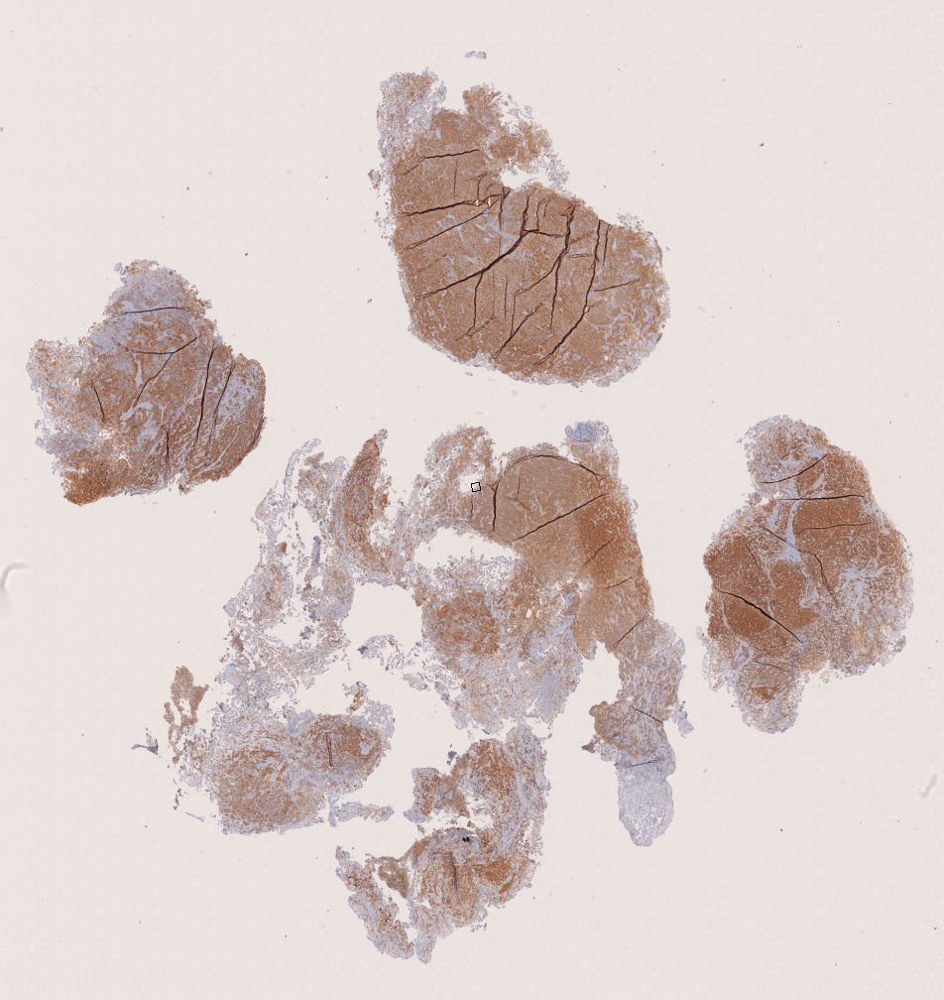

In [52]:
aff_with_scale = sitk.CompositeTransform([preScale, aff_tfm, reScale])
ul_2 = aff_with_scale.TransformPoint(ul_1)
ur_2 = aff_with_scale.TransformPoint(ur_1)
ll_2 = aff_with_scale.TransformPoint(ll_1)
lr_2 = aff_with_scale.TransformPoint(lr_1)
overlayim2_inv_bsp_aff = Image.new("RGBA", he_pic_lv6.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim2_inv_bsp_aff)
draw.line(ul_2+ur_2, fill=(0,0,0,255), width=1)
draw.line(ur_2+lr_2, fill=(0,0,0,255), width=1)
draw.line(lr_2+ll_2, fill=(0,0,0,255), width=1)
draw.line(ll_2+ul_2, fill=(0,0,0,255), width=1)
squ_ihc_lv6 = ihc_pic_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1]))
# Image.blend(ihc_trl_aff_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1])),
#             overlayim2_inv_bsp, 0.5)
squ_ihc_lv6.paste(overlayim2_inv_bsp_aff, (0,0), overlayim2_inv_bsp_aff)
squ_ihc_lv6

Now, let's transform the points in one swoop:

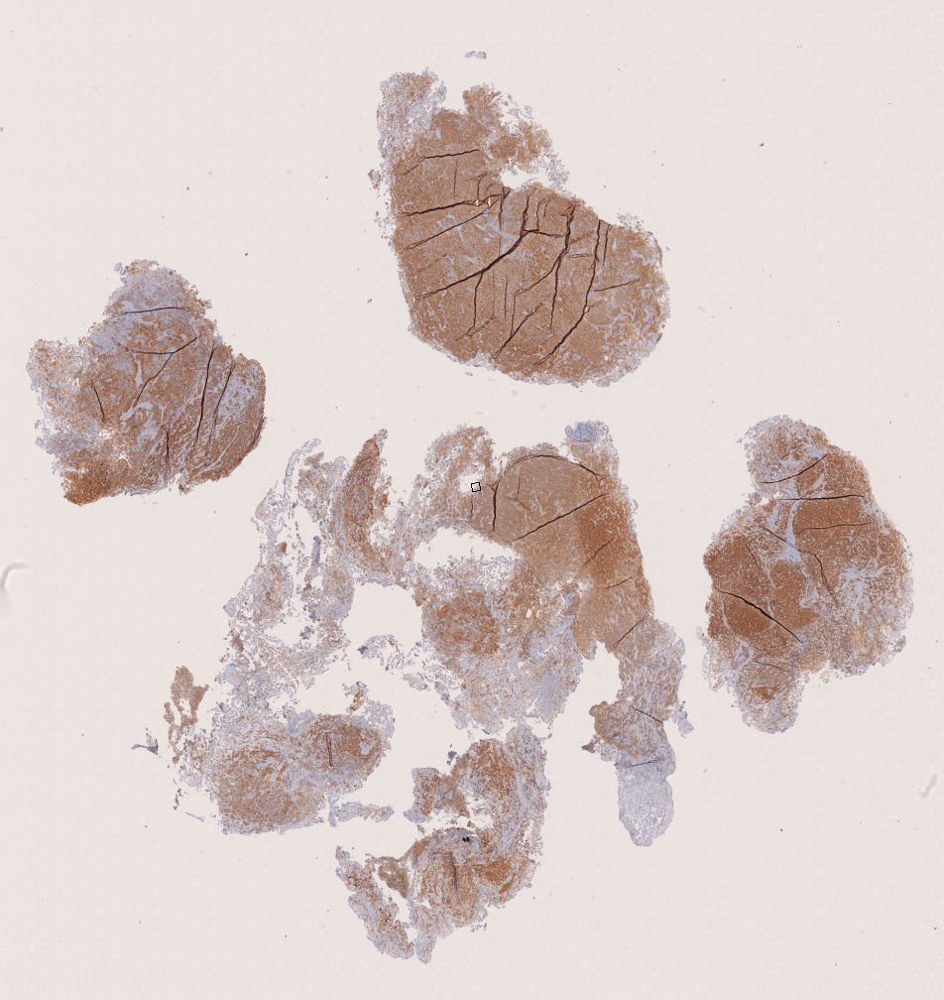

In [53]:
complete_tfm_with_scale = sitk.CompositeTransform([preScale, aff_tfm, bsp_tfm, reScale])
ul_f = complete_tfm_with_scale.TransformPoint(ul)
ur_f = complete_tfm_with_scale.TransformPoint(ur)
ll_f = complete_tfm_with_scale.TransformPoint(ll)
lr_f = complete_tfm_with_scale.TransformPoint(lr)
overlayim2_final = Image.new("RGBA", he_pic_lv6.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim2_final)
draw.line(ul_f+ur_f, fill=(0,0,0,255), width=1)
draw.line(ur_f+lr_f, fill=(0,0,0,255), width=1)
draw.line(lr_f+ll_f, fill=(0,0,0,255), width=1)
draw.line(ll_f+ul_f, fill=(0,0,0,255), width=1)

# final_blend = Image.blend(ihc_pic_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1])),
#             overlayim2_inv_bsp_aff, 0.5)
final_blend = ihc_pic_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1]))
final_blend.paste(overlayim2_final, (0,0), overlayim2_final)
final_blend

Now why is that approach sufficient? Because drawing a bounding box around the transformed corner points gives us almost all pixels we need for the target tile.

Why "almost"? Because due to the nonlinear nature to BSpline transformations, it's possible for the target tissue to bulge out of the bounding box inbetween corner points. Luckily, our BSpline approach constrains the degree to which the image is bent, so just adding a good safety margin to the area that is being extracted will be sufficient.

We used a square size of `8` in this approach. Using half of that on all sides each gives us a good safety margin to be sure that we extract all relevant pixels:

In [54]:
import math
x_min = math.floor(min(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
x_min

475

In [55]:
y_min = math.floor(min(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
y_min

486

In [56]:
x_max = math.ceil(max(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
x_max

485

In [57]:
y_max = math.ceil(max(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
y_max

496

In [58]:
square_size = 8
safety_margin = square_size/2

In [59]:
ul_bb = (x_min - safety_margin,
         y_min - safety_margin)
ur_bb = (x_max + safety_margin,
         y_min - safety_margin)
ll_bb = (x_min - safety_margin,
         y_max + safety_margin)
lr_bb = (x_max + safety_margin,
         y_max + safety_margin)

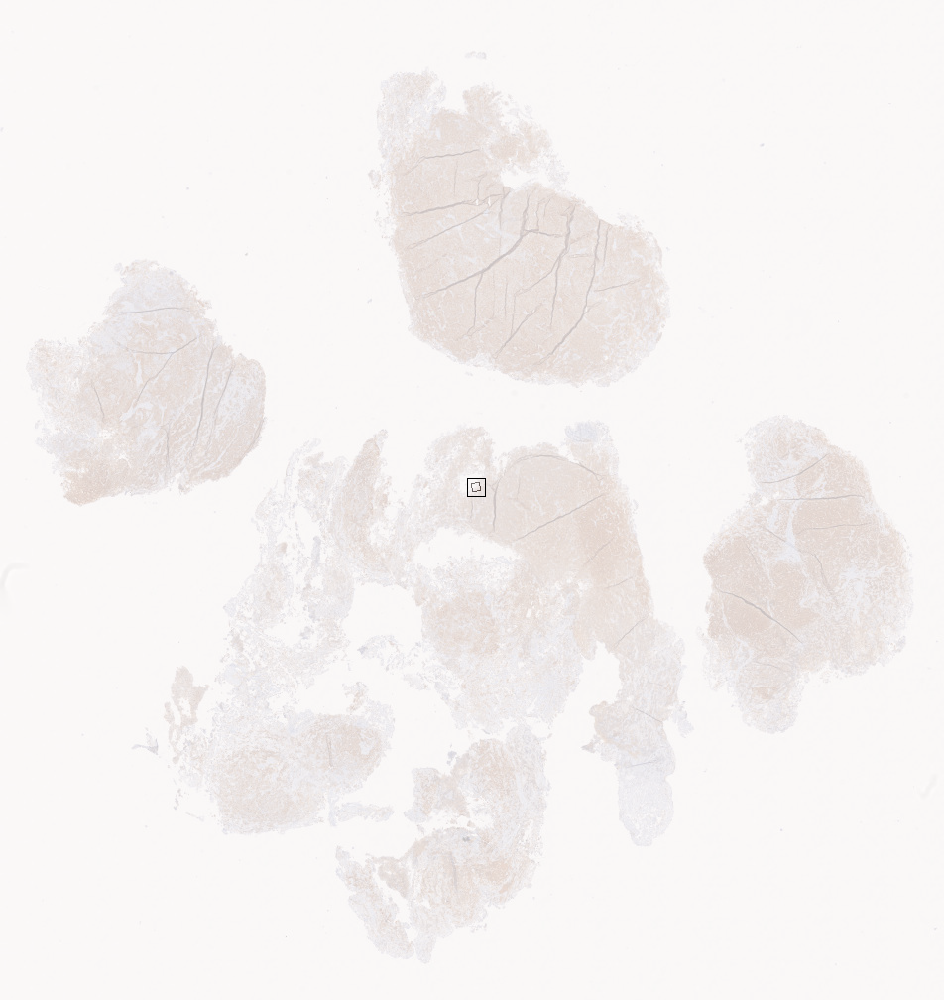

In [60]:
overlayim_with_margin = Image.new("RGBA", he_pic_lv6.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_bb+ur_bb, fill=(0,0,0,255), width=1)
draw.line(ur_bb+lr_bb, fill=(0,0,0,255), width=1)
draw.line(lr_bb+ll_bb, fill=(0,0,0,255), width=1)
draw.line(ll_bb+ul_bb, fill=(0,0,0,255), width=1)

final_blend_2 = Image.blend(ihc_pic_lv6.crop((0,0,he_pic_lv6.size[0],he_pic_lv6.size[1])),
            overlayim2_inv_bsp_aff, 0.5)
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)
final_blend_2

## Finally, the full function

For the ultimate demonstration of this approach, let us now try to extract this exact tile and transform it, and let's monitor the performance of the process.

In [61]:
sum_of_tuples = lambda a, b : tuple(map(sum, zip(a, b)))
def get_tfmd_tile(wsi_slide, orig_level, target_level, ul_corner, area_size, aff, bsp):
    
    # get the right tfm for corner recalculation
    scale_fac = 2**(orig_level-target_level)
    preScale = sitk.ScaleTransform(2, (scale_fac,scale_fac))
    reScale = sitk.ScaleTransform(2, (1/scale_fac,1/scale_fac))
    tfm_with_scale = sitk.CompositeTransform([preScale, aff, bsp, reScale])
    
    # add safety margin *before* transformation because we won't subtract it until afterwards either
    safety_margin = 1*(int)((area_size[0]+area_size[1])/4) # half of the mean of the area side lengths
#     safety_margin = 0
    
    # recalculate points
    ul_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]-safety_margin))
    ur_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]-safety_margin))
    ll_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]+area_size[1]+safety_margin))
    lr_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]+area_size[1]+safety_margin))

    # get new corners
    x_min = math.floor(min(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
    y_min = math.floor(min(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
    x_max = math.ceil(max(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
    y_max = math.ceil(max(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))

    # get tile
    wsi_tile = wsi_slide.read_region((x_min*2**target_level,y_min*2**target_level), # keep in mind, this requires the top left pixel ON LEVEL 0
                                     target_level,
                                     (x_max-x_min, y_max-y_min))
    # to bring the tile into the right position for the transformation to work,
    # let's add translations to the composite transform
    preTranslate = sitk.TranslationTransform(2, [-1*x_min, -1*y_min])
    postTranslate = sitk.TranslationTransform(2, [ul_corner[0], ul_corner[1]])
    full_tfm = sitk.CompositeTransform([preTranslate, preScale, aff, bsp, reScale, postTranslate])

    return color_transform(wsi_tile, full_tfm).crop((0,0)+area_size)

In the beginning of section 3.1, we used the following coordinates:

In [62]:
(x,x,x+8,x+8)

(478, 478, 486, 486)

However, These coordinates were only viable for level `6`. To operate on level `0`, we need to multiply the coordinates by 2^6 = 64

→ we get a tile size of 8*64=512. Just what we wanted :)

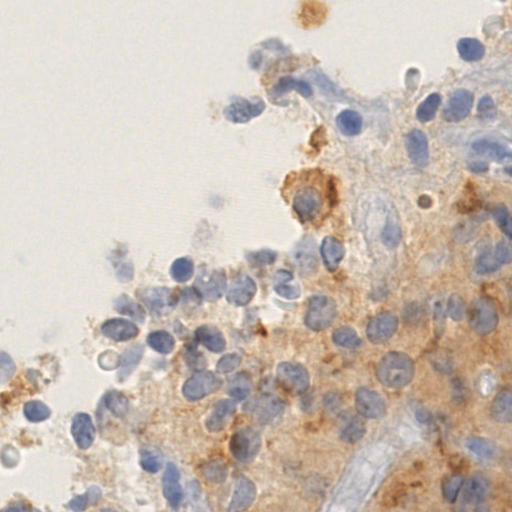

In [63]:
orig_tfm_level = 7
target_tfm_level = 0
lv_fac = 6-target_tfm_level

xyz = get_tfmd_tile(slide.open_slide(pair["ihc path"]),
              orig_tfm_level, # orig_level
              target_tfm_level, # target_level
              (x*2**lv_fac,x*2**lv_fac), # upper left corner, in target_level dimensions
              (8*2**lv_fac,8*2**lv_fac), # area_size, in target_level dimensions
              aff_tfm, bsp_tfm)
xyz

Awesome. Now to make sure that we weren't just lucky, let's pick another area:

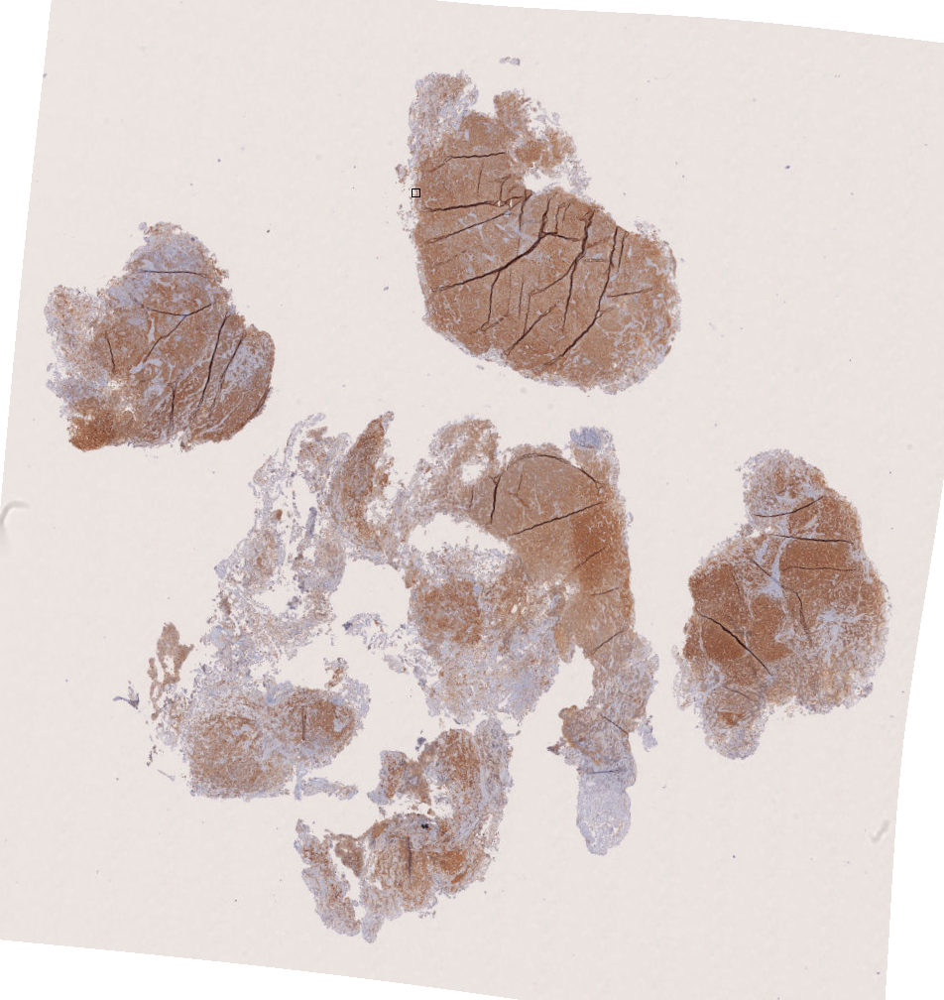

In [64]:
new_ul = (415,190)
new_square = new_ul + sum_of_tuples(new_ul, (8,8))
ihc_tfmd_copy = ihc_tfmd_lv6_good.crop((0,0)+ihc_tfmd_lv6_good.size)

draw = ImageDraw.Draw(ihc_tfmd_copy)
draw.line((new_square[0], new_square[1], new_square[2], new_square[1]), fill=(0,0,0,255), width=1)
draw.line((new_square[2], new_square[1], new_square[2], new_square[3]), fill=(0,0,0,255), width=1)
draw.line((new_square[2], new_square[3], new_square[0], new_square[3]), fill=(0,0,0,255), width=1)
draw.line((new_square[0], new_square[3], new_square[0], new_square[1]), fill=(0,0,0,255), width=1)

ihc_tfmd_copy

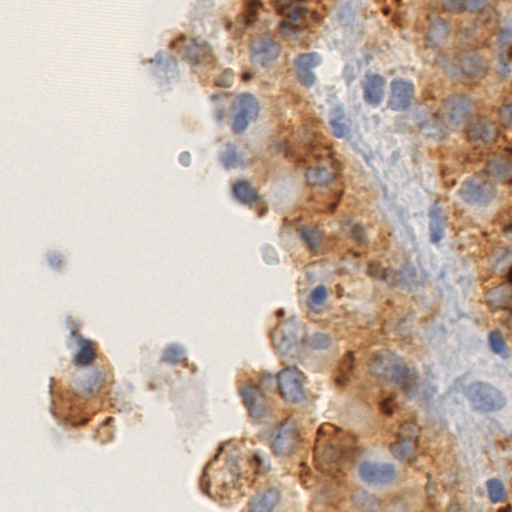

In [65]:
xyz = get_tfmd_tile(slide.open_slide(pair["ihc path"]),
              orig_tfm_level, # orig_level
              target_tfm_level, # target_level
              (new_ul[0]*2**lv_fac,new_ul[1]*2**lv_fac), # upper left corner, in target_level dimensions
              (8*2**lv_fac,8*2**lv_fac), # area_size, in target_level dimensions
              aff_tfm, bsp_tfm)
xyz

In [66]:
xyz.size

(512, 512)

Good stuff.

...time?

CPU times: user 2.25 s, sys: 71.6 ms, total: 2.33 s
Wall time: 10.2 s


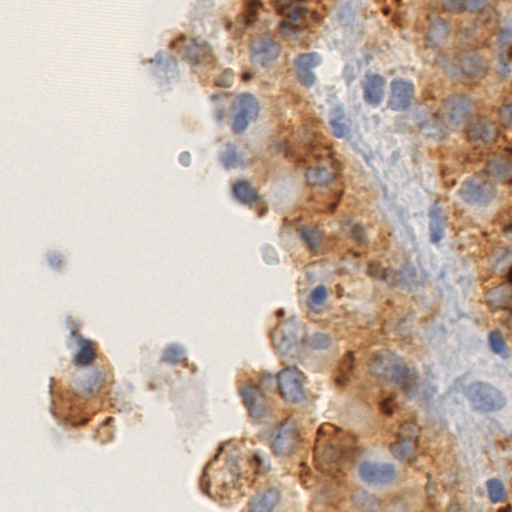

In [89]:
%time get_tfmd_tile(slide.open_slide(pair["ihc path"]),orig_tfm_level, target_tfm_level,(new_ul[0]*2**lv_fac,new_ul[1]*2**lv_fac),(8*2**lv_fac,8*2**lv_fac), aff_tfm, bsp_tfm)

Yes, good. Very efficient.

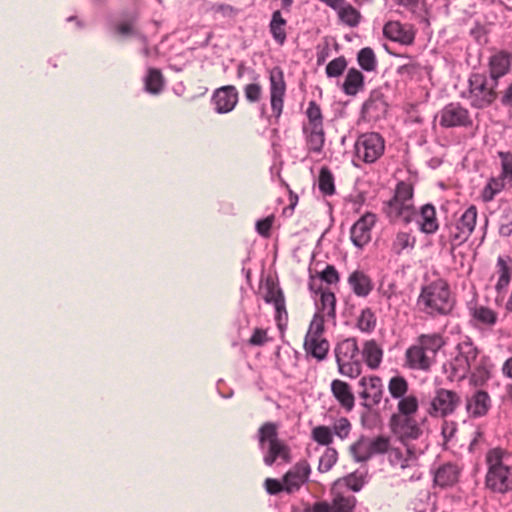

In [68]:
wsi_tile_he = slide.open_slide(pair["he path"]).read_region((new_ul[0]*2**lv_fac,new_ul[1]*2**lv_fac),
                                     0,
                                     (512,512))
wsi_tile_he

## Calculating duration for all slides

Quick and dirty: Use some middle tile of the ihc slide.

In [146]:
sum_of_tuples = lambda a, b : tuple(map(sum, zip(a, b)))
def get_tfmd_tile_for_timing(wsi_slide, orig_level, target_level, area_size, aff, bsp):
    
    # get the right tfm for corner recalculation
    scale_fac = 2**(orig_level-target_level)
    preScale = sitk.ScaleTransform(2, (scale_fac,scale_fac))
    reScale = sitk.ScaleTransform(2, (1/scale_fac,1/scale_fac))
    tfm_with_scale = sitk.CompositeTransform([preScale, aff, bsp, reScale])
    
    # add safety margin *before* transformation because we won't subtract it until afterwards either
    safety_margin = 1*(int)((area_size[0]+area_size[1])/4) # half of the mean of the area side lengths
#     safety_margin = 0
    
    ul_corner = (round(wsi_slide.level_dimensions[target_level][0]/2),
                 round(wsi_slide.level_dimensions[target_level][1]/2))
    
    # recalculate points
    ul_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]-safety_margin))
    ur_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]-safety_margin))
    ll_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]+area_size[1]+safety_margin))
    lr_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]+area_size[1]+safety_margin))

    # get new corners
    x_min = math.floor(min(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
    y_min = math.floor(min(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
    x_max = math.ceil(max(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
    y_max = math.ceil(max(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))

    # get tile
    wsi_tile = wsi_slide.read_region((x_min*2**target_level,y_min*2**target_level), # keep in mind, this requires the top left pixel ON LEVEL 0
                                     target_level,
                                     (x_max-x_min, y_max-y_min))
    # to bring the tile into the right position for the transformation to work,
    # let's add translations to the composite transform
    preTranslate = sitk.TranslationTransform(2, [-1*x_min, -1*y_min])
    postTranslate = sitk.TranslationTransform(2, [ul_corner[0], ul_corner[1]])
    full_tfm = sitk.CompositeTransform([preTranslate, preScale, aff, bsp, reScale, postTranslate])

    return color_transform(wsi_tile, full_tfm).crop((0,0)+area_size)

In [78]:
from datetime import datetime
import pytz
import time
tz = pytz.timezone("Europe/Berlin")
print(datetime.now(tz).strftime("%d.%m.%Y, %H:%M:%S"))

15.10.2023, 00:54:12


In [154]:
testoutput = None

In [158]:
timesDict = {}

orig_tfm_level = 7
target_tfm_level = 0
lv_fac = 6-target_tfm_level
aff_tfm = sitk.ReadTransform(pair["aff path"])
bsp_tfm = sitk.ReadTransform(pair["bsp path"])

def measureTimes():
    global testoutput
    with open('out.txt', 'a+') as f:
        print("Measuring times!", file = f)
        print(datetime.now(tz).strftime("%d.%m.%Y, %H:%M:%S"), file = f)

    for index, pair in pair_df.iterrows():
        if index>615:
            break;
        if pair["unusable"]:
            with open('out.txt', 'a+') as f:
                print("INDEX" + str(index) + ": unusable!!", file = f)
            continue;
        success = False # we will print an error later if success isn't True
        
        timestartThisCase = time.time() # measure time for the whole case
        for j in range(3): # we give each pair a maximum of three attempts before printing an error
            try:
                testoutput = get_tfmd_tile_for_timing(slide.open_slide(pair["ihc path"]),orig_tfm_level, target_tfm_level,(512,512), aff_tfm, bsp_tfm)
                success = True

                with open('out.txt', 'a+') as f:
                    print(datetime.now(tz).strftime("%d.%m.%Y, %H:%M:%S") + ': index ' + str(index) + ' successful', file=f)  # Python 3.x

                break
            except:
                # if an error is thrown, we want to log it together with a timestamp and the index
                with open('out.txt', 'a+') as f:
                    print(datetime.now(tz).strftime("%d.%m.%Y, %H:%M:%S") + ': index ' + str(index) + ' error' + str(j) + ':', file=f)  # Python 3.x
                    print(sys.exc_info()[0], file=f)
                continue
        if not success:
            # after three attempts, log this message:
            with open('out.txt', 'a+') as f:
                print(datetime.now(tz).strftime("%d.%m.%Y, %H:%M:%S") + ': PROBLEM WITH INDEX ' + str(index) + ", MOVING ON", file=f)  # Python 3.x
            
        # save the time everything took:
        full_duration_ms = round((time.time() - timestartThisCase)*1000)
        timesDict[index] = full_duration_ms
        
        with open(output_path/'timesDict.txt', 'w') as f:
            print(timesDict, file=f)  # Python 3.x
                
# This code is commented out because we only want to execute it once.
measureTimes()

In [159]:
minTime = min(list(timesDict.values()))
minTime

2658

In [160]:
minInd = [x for x in timesDict if timesDict[x] == min(list(timesDict.values()))][0]
minInd

511

In [161]:
pair = pair_df.iloc[[minInd]].squeeze()
# dims = slide.open_slide(pair["he path"]).level_dimensions[0]
# new_ul = (round(dims[0]/2), round(dims[1]/2))

dims = slide.open_slide(pair["he path"]).level_dimensions[7]
dims2 = (dims[0] - pair["crop he left"] - pair["crop he right"], dims[1] - pair["crop he top"] - pair["crop he bottom"])

new_ul_7 = (round(dims2[0]/2+pair["crop he left"]), round(dims2[1]/2+pair["crop he top"]))
new_ul = (new_ul_7[0]*128, new_ul_7[1]*128)

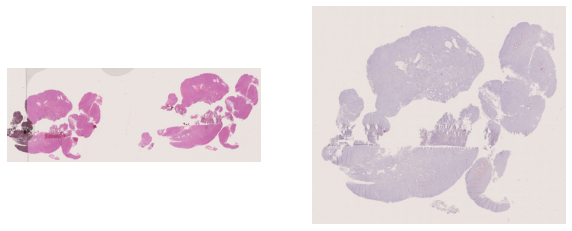

In [133]:
ihc_slide = slide.open_slide(pair["ihc path"])
he_slide = slide.open_slide(pair["he path"])
he_pic_lv7 = he_slide.read_region((0,0),
                             7,
                             he_slide.level_dimensions[7])
ihc_pic_lv7 = ihc_slide.read_region((0,0),
                                 7,
                                 ihc_slide.level_dimensions[7])
display_n_2d_arrays([he_pic_lv7, ihc_pic_lv7])

In [162]:
%time testoutput = get_tfmd_tile_for_timing(slide.open_slide(pair["ihc path"]),orig_tfm_level, target_tfm_level,(512,512), aff_tfm, bsp_tfm)

CPU times: user 1.59 s, sys: 17.1 ms, total: 1.61 s
Wall time: 1.47 s


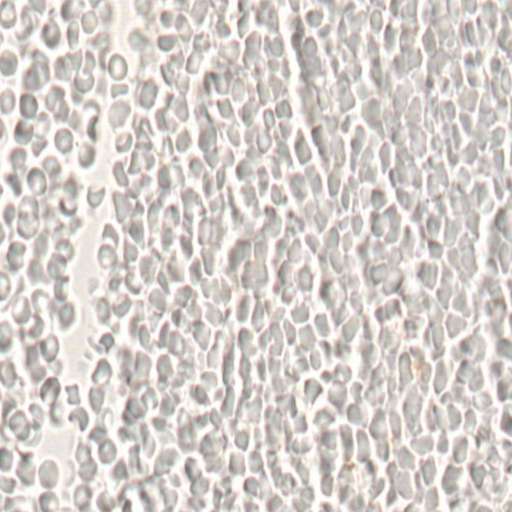

In [163]:
testoutput

# Demonstrations for the paper

## Preparations

In [70]:
index = 15
pair = pair_df.iloc[[index]].squeeze()

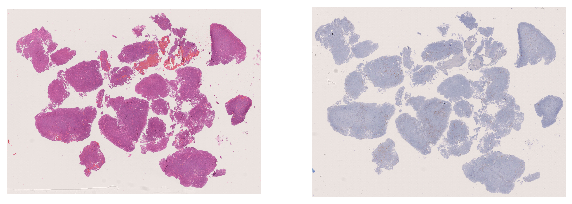

In [71]:
ihc_slide = slide.open_slide(pair["ihc path"])
he_slide = slide.open_slide(pair["he path"])
he_pic_lv7 = he_slide.read_region((0,0),
                             7,
                             he_slide.level_dimensions[7])
ihc_pic_lv7 = ihc_slide.read_region((0,0),
                                 7,
                                 ihc_slide.level_dimensions[7])
display_n_2d_arrays([he_pic_lv7, ihc_pic_lv7])

In [72]:
ihc_pic_lv7_tfmd = color_transform(ihc_pic_lv7, get_full_transform(pair)).crop((0,0)+he_pic_lv7.size)
interact(displayAlternating,
         imArr =  fixed([he_pic_lv7, ihc_pic_lv7_tfmd]),
         whichone = (0,1,1))

interactive(children=(IntSlider(value=0, description='whichone', max=1), Output()), _dom_classes=('widget-inte…

<function __main__.displayAlternating(imArr, whichone)>

## Part 1

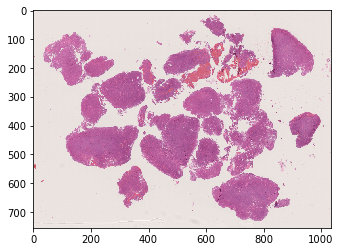

In [73]:
plt.imshow(he_pic_lv7)
plt.savefig(str(index)+"_he_pic_lv7_plot.png", dpi=300)

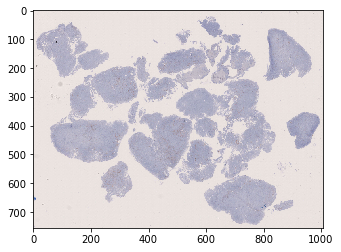

In [74]:
plt.imshow(ihc_pic_lv7)
plt.savefig(str(index)+"_ihc_pic_lv7_plot.png", dpi=300)

In [75]:
he_pic_lv4 = he_slide.read_region((0,0),
                             4,
                             he_slide.level_dimensions[4])
ihc_pic_lv4 = ihc_slide.read_region((0,0),
                                 4,
                                 ihc_slide.level_dimensions[4])

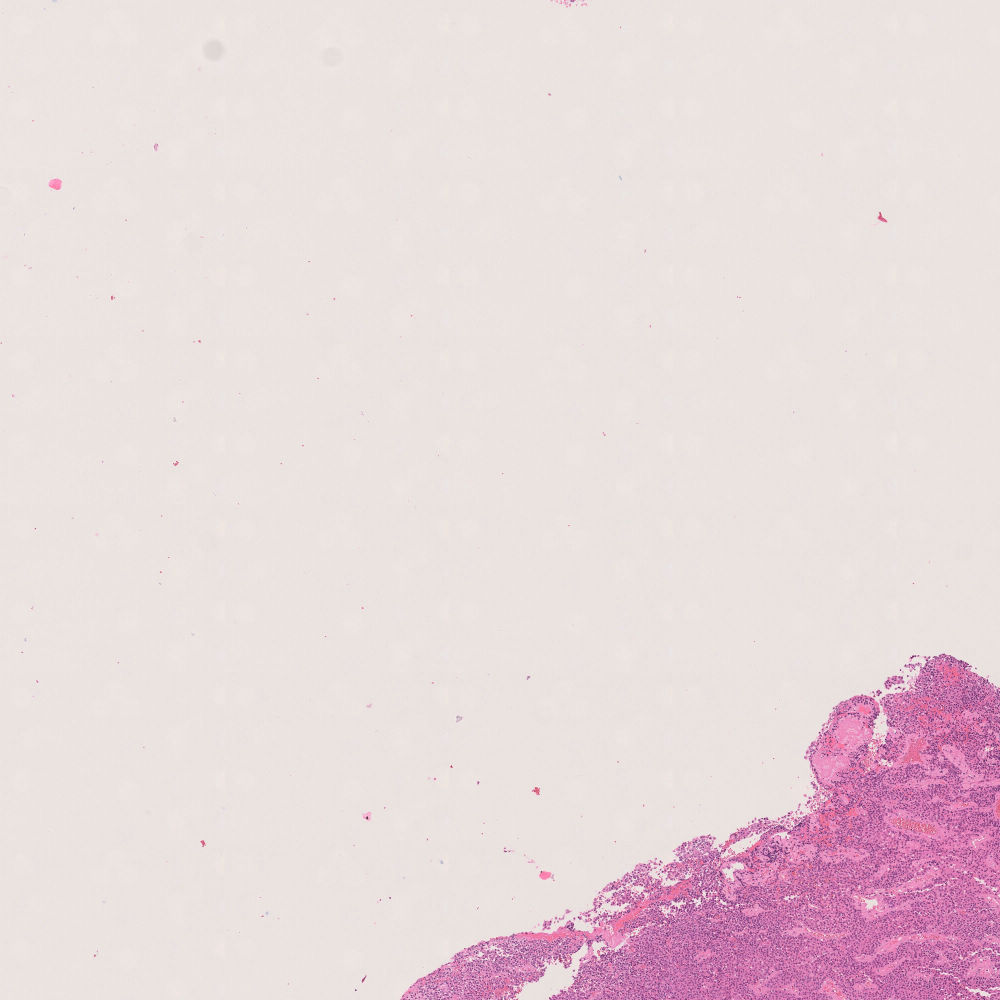

In [76]:
he_pic_lv4.crop((0, 0,250*4,250*4))

In [77]:
# %time he_pic_lv0 = he_slide.read_region((0,0), 0, (32000,32000))

Extracting 32,000*32,000 pixels from a lv0-image takes about 17 minutes, so we won't do that. Instead, we'll trick around a bit:

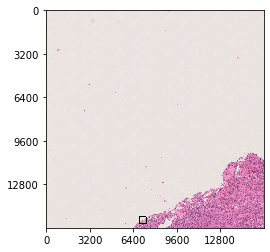

In [78]:
x = 107*4
y = 237*4
sqSize = 8*4
thisWidth = 1*4
cropperMargin = 250*4

ul = (x,y) # upper left
ur = (x+sqSize,y) # upper right
ll = (x,y+sqSize) # lower left
lr = (x+sqSize,y+sqSize) # lower right
overlayim_with_margin = Image.new("RGBA", (cropperMargin,cropperMargin), (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul+ur, fill=(0,0,0,255), width=thisWidth)
draw.line(ur+lr, fill=(0,0,0,255), width=thisWidth)
draw.line(lr+ll, fill=(0,0,0,255), width=thisWidth)
draw.line(ll+ul, fill=(0,0,0,255), width=thisWidth)

final_blend_2 = he_pic_lv4.crop((0,0,cropperMargin,cropperMargin))
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)

ax = plt.imshow(final_blend_2)
plt.savefig(str(index)+"_sqr_he_pic_lv4.png", dpi=300)
new_x_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_xticklabels()]
new_y_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_yticklabels()]
ax.axes.set_xticklabels(new_x_labels)
ax.axes.set_yticklabels(new_y_labels)
# plt.show()
plt.savefig(str(index)+"_sqr_he_pic_lv0.png", dpi=300)

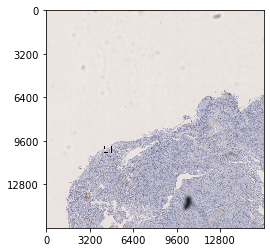

In [79]:
ul_corner = (x,y) # in lv4
ul_corner_0 = (x*16,y*16) # in lv0
area_size = (sqSize, sqSize) # in lv4
scale_fac = 2**(7-4)
preScale = sitk.ScaleTransform(2, (scale_fac,scale_fac))
reScale = sitk.ScaleTransform(2, (1/scale_fac,1/scale_fac))
aff_tfm = sitk.ReadTransform(pair["aff path"])
bsp_tfm = sitk.ReadTransform(pair["bsp path"])
tfm_with_scale = sitk.CompositeTransform([preScale, aff_tfm, bsp_tfm, reScale])

safety_margin = 0

# recalculate points
ul_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]-safety_margin))
ur_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]-safety_margin))
ll_f = tfm_with_scale.TransformPoint((ul_corner[0]-safety_margin, ul_corner[1]+area_size[1]+safety_margin))
lr_f = tfm_with_scale.TransformPoint((ul_corner[0]+area_size[0]+safety_margin, ul_corner[1]+area_size[1]+safety_margin))

thisWidth = 1*4
cropperMargin = 250*4

overlayim_with_margin = Image.new("RGBA", (cropperMargin,cropperMargin), (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_f+ur_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ur_f+lr_f, fill=(0,0,0,255), width=thisWidth)
draw.line(lr_f+ll_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ll_f+ul_f, fill=(0,0,0,255), width=thisWidth)

final_blend_2 = ihc_pic_lv4.crop((0,0,cropperMargin,cropperMargin))
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)

ax = plt.imshow(final_blend_2)
plt.savefig(str(index)+"_sqr_ihc_pic_lv4.png", dpi=300)
new_x_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_xticklabels()]
new_y_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_yticklabels()]
ax.axes.set_xticklabels(new_x_labels)
ax.axes.set_yticklabels(new_y_labels)
# plt.show()
plt.savefig(str(index)+"_sqr_ihc_pic_lv0.png", dpi=300)

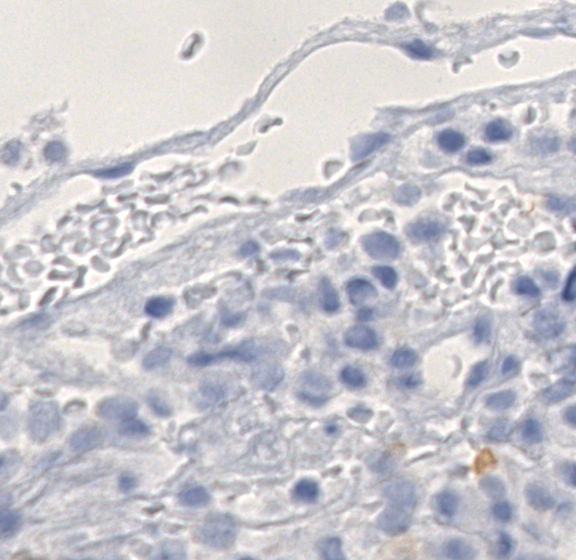

In [80]:
# get new corners
x_min = math.floor(min(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
y_min = math.floor(min(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
x_max = math.ceil(max(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
y_max = math.ceil(max(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))

# get tile
wsi_tile = ihc_slide.read_region((x_min*16,y_min*16),
                                 0,
                                 ((x_max-x_min)*16, (y_max-y_min)*16))
wsi_tile

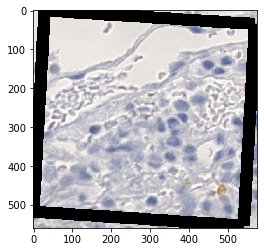

In [81]:
ul_t = ((ul_f[0]-x_min)*16, (ul_f[1]-y_min)*16)
ur_t = ((ur_f[0]-x_min)*16, (ur_f[1]-y_min)*16)
ll_t = ((ll_f[0]-x_min)*16, (ll_f[1]-y_min)*16)
lr_t = ((lr_f[0]-x_min)*16, (lr_f[1]-y_min)*16)

thisWidth = 32

overlayim_with_margin = Image.new("RGBA", wsi_tile.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_t+ur_t, fill=(0,0,0,255), width=thisWidth)
draw.line(ur_t+lr_t, fill=(0,0,0,255), width=thisWidth)
draw.line(lr_t+ll_t, fill=(0,0,0,255), width=thisWidth)
draw.line(ll_t+ul_t, fill=(0,0,0,255), width=thisWidth)
final_blend_2 = wsi_tile.copy()
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)

ax = plt.imshow(final_blend_2)
plt.savefig(str(index)+"_tile_ihc_pic_lv0.png", dpi=300)

## Part 2

In [82]:
ihc_pic_lv4.size

(8064, 6048)

Let's transform the lv4 WSI and recreate the marks

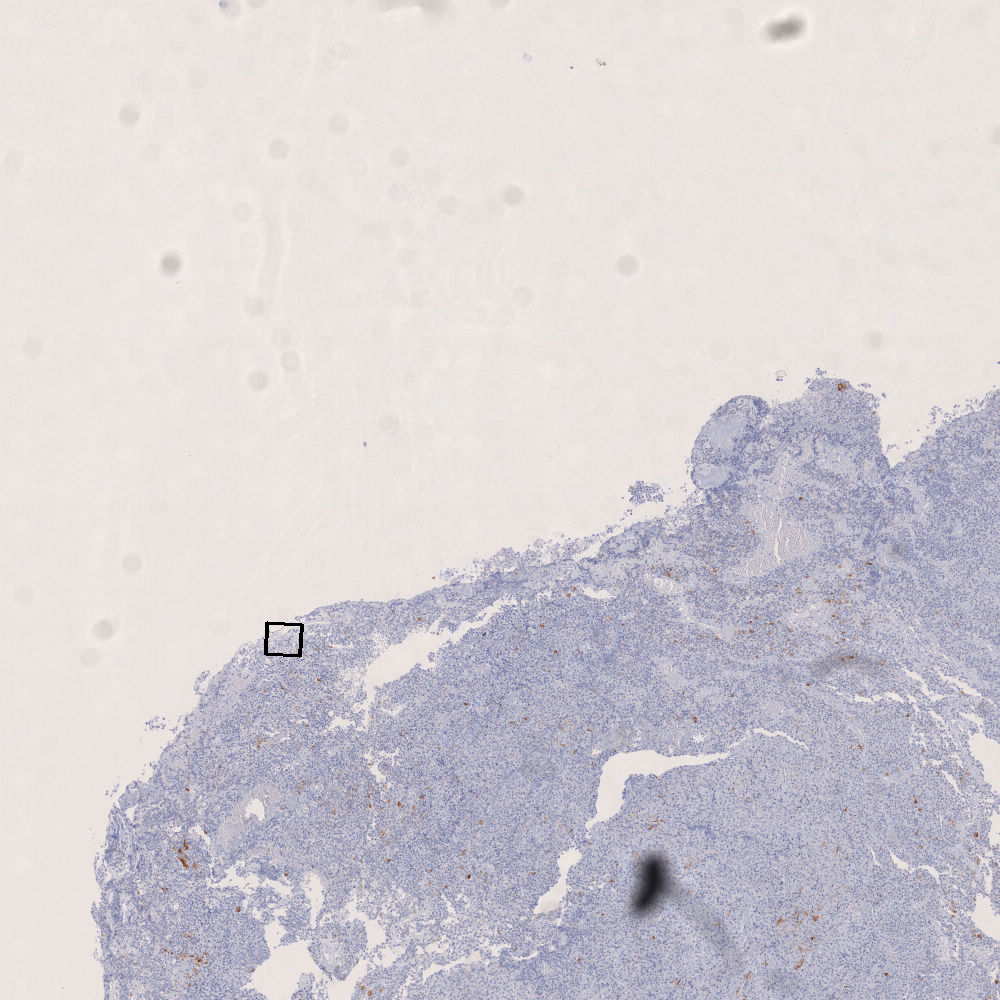

In [83]:
thisWidth = 4

overlayim_with_margin = Image.new("RGBA", (cropperMargin,cropperMargin), (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_f+ur_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ur_f+lr_f, fill=(0,0,0,255), width=thisWidth)
draw.line(lr_f+ll_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ll_f+ul_f, fill=(0,0,0,255), width=thisWidth)

final_blend_2 = ihc_pic_lv4.crop((0,0,cropperMargin,cropperMargin))
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)
final_blend_2

In [84]:
# # get new corners
# x_min = math.floor(min(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
# y_min = math.floor(min(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))
# x_max = math.ceil(max(ul_f[0], ur_f[0], ll_f[0], lr_f[0]))
# y_max = math.ceil(max(ul_f[1], ur_f[1], ll_f[1], lr_f[1]))

# # get tile
# l4_wsi_tile = final_blend_2.crop((x_min, y_min, x_max, y_max))
# l4_wsi_tile

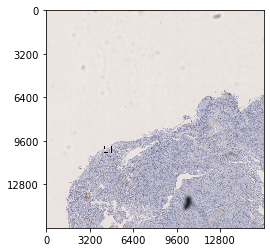

In [85]:
ax = plt.imshow(final_blend_2)
plt.savefig(str(index)+"_trl_ihc_pic_lv4.png", dpi=300)
new_x_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_xticklabels()]
new_y_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_yticklabels()]
ax.axes.set_xticklabels(new_x_labels)
ax.axes.set_yticklabels(new_y_labels)
# plt.show()
plt.savefig(str(index)+"_trl_ihc_pic_lv0.png", dpi=300)

In [86]:
ihc_pic_lv4.size[0]/128 * 16

1008.0

In [87]:
ul_7 = (int(round(ul_f[0]/8)), int(round(ul_f[1]/8)))
ul_7

(33, 78)

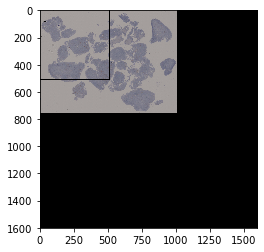

In [88]:
from PIL import Image, ImageEnhance
lr_7 = (ul_7[0]+10, ul_7[1]+10)
ihc_lv7_darker = ihc_pic_lv7.crop((0,0,1600,1600))
draw = ImageDraw.Draw(ihc_lv7_darker)
draw.rectangle(ul_7+lr_7, fill=None, outline=(0,0,0,255), width=5)

enhancer = ImageEnhance.Brightness(ihc_lv7_darker)
# to reduce brightness by 50%, use factor 0.5
ihc_lv7_darker = enhancer.enhance(0.7)

black_background = Image.new("RGBA", (1600,1600), (0,0,0,255))
black_background.paste(ihc_lv7_darker, (0,0), ihc_lv7_darker)

draw = ImageDraw.Draw(black_background)
draw.line((0,0,0,512), fill=(0,0,0,255), width=5)
draw.line((0,512,512,512), fill=(0,0,0,255), width=5)
draw.line((512,512,512,0), fill=(0,0,0,255), width=5)
draw.line((512,0,0,0), fill=(0,0,0,255), width=5)

ax = plt.imshow(black_background, extent=(0, 1600, 1600, 0))
plt.savefig(str(index)+"_down_ihc_pic_lv7.png", dpi=300)

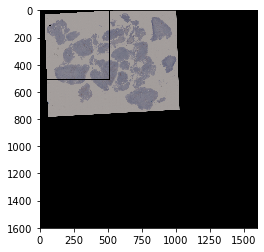

In [89]:
ihc_lv7_darker_tfmd = color_transform(ihc_lv7_darker.crop((0,0,ihc_lv7_darker.size[0]*2, ihc_lv7_darker.size[1]*2)), aff_tfm).crop((0,0,1600,1600))

black_background = Image.new("RGBA", (1600,1600), (0,0,0,255))
black_background.paste(ihc_lv7_darker_tfmd, (0,0), ihc_lv7_darker_tfmd)

draw = ImageDraw.Draw(black_background)
draw.line((0,0,0,512), fill=(0,0,0,255), width=5)
draw.line((0,512,512,512), fill=(0,0,0,255), width=5)
draw.line((512,512,512,0), fill=(0,0,0,255), width=5)
draw.line((512,0,0,0), fill=(0,0,0,255), width=5)

ax = plt.imshow(black_background, extent=(0, 1600, 1600, 0))
plt.savefig(str(index)+"_aff_ihc_pic_lv7.png", dpi=300)

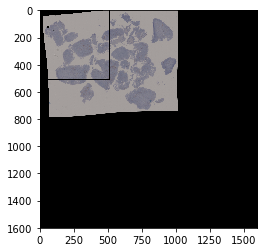

In [90]:
ihc_lv7_darker_tfmd2 = color_transform(ihc_lv7_darker.crop((0,0,ihc_lv7_darker.size[0]*2, ihc_lv7_darker.size[1]*2)), sitk.CompositeTransform([aff_tfm, bsp_tfm])).crop((0,0,1600,1600))

black_background = Image.new("RGBA", (1600,1600), (0,0,0,255))
black_background.paste(ihc_lv7_darker_tfmd2, (0,0), ihc_lv7_darker_tfmd2)

draw = ImageDraw.Draw(black_background)
draw.line((0,0,0,512), fill=(0,0,0,255), width=5)
draw.line((0,512,512,512), fill=(0,0,0,255), width=5)
draw.line((512,512,512,0), fill=(0,0,0,255), width=5)
draw.line((512,0,0,0), fill=(0,0,0,255), width=5)

ax = plt.imshow(black_background, extent=(0, 1600, 1600, 0))
plt.savefig(str(index)+"_bsp_ihc_pic_lv7.png", dpi=300)

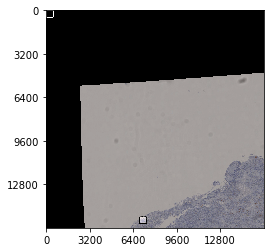

In [91]:
thisWidth = 4
cropperMargin = 250*5
cropperMargin2 = 250*4

overlayim_with_margin = Image.new("RGBA", (cropperMargin,cropperMargin), (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_f+ur_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ur_f+lr_f, fill=(0,0,0,255), width=thisWidth)
draw.line(lr_f+ll_f, fill=(0,0,0,255), width=thisWidth)
draw.line(ll_f+ul_f, fill=(0,0,0,255), width=thisWidth)

final_blend_2 = ihc_pic_lv4.crop((0,0,cropperMargin,cropperMargin))
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)

scale_fac = 2**(7-4)
preScale = sitk.ScaleTransform(2, (scale_fac,scale_fac))
reScale = sitk.ScaleTransform(2, (1/scale_fac,1/scale_fac))
full_tfm = sitk.CompositeTransform([preScale, aff_tfm, bsp_tfm, reScale])
final_blend_2 = color_transform(final_blend_2, full_tfm).crop((0,0,cropperMargin2,cropperMargin2))
final_blend_2_darker = final_blend_2.copy()

enhancer = ImageEnhance.Brightness(final_blend_2_darker)
final_blend_2_darker = enhancer.enhance(0.7)
mask = Image.new("RGBA", (cropperMargin2,cropperMargin2), (0,0,0,0))
draw = ImageDraw.Draw(mask)
draw.rectangle(ul+lr, fill=(0,0,0,255))
final_blend_2_darker.paste(final_blend_2, (0,0), mask)
black_background = Image.new("RGBA", (cropperMargin2,cropperMargin2), (0,0,0,255))
black_background.paste(final_blend_2_darker, (0,0), final_blend_2_darker)

draw = ImageDraw.Draw(black_background)
draw.line((0,0,0,32), fill=(255,255,255,255), width=5)
draw.line((0,32,32,32), fill=(255,255,255,255), width=5)
draw.line((32,32,32,0), fill=(255,255,255,255), width=5)
draw.line((32,0,0,0), fill=(255,255,255,255), width=5)

ax = plt.imshow(black_background)
plt.savefig(str(index)+"_up_ihc_pic_lv4.png", dpi=300)
new_x_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_xticklabels()]
new_y_labels = [int(item.get_text().replace("−", "-")) * 16 for item in ax.axes.get_yticklabels()]
ax.axes.set_xticklabels(new_x_labels)
ax.axes.set_yticklabels(new_y_labels)
# plt.show()
plt.savefig(str(index)+"_up_ihc_pic_lv0.png", dpi=300)

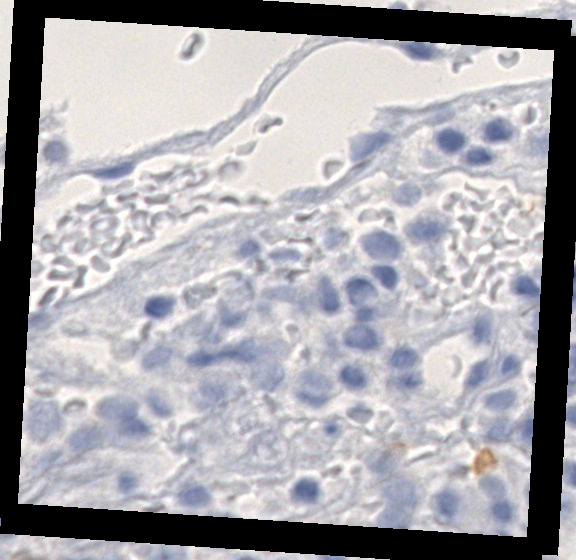

In [92]:
ul_t = ((ul_f[0]-x_min)*16, (ul_f[1]-y_min)*16)
ur_t = ((ur_f[0]-x_min)*16, (ur_f[1]-y_min)*16)
ll_t = ((ll_f[0]-x_min)*16, (ll_f[1]-y_min)*16)
lr_t = ((lr_f[0]-x_min)*16, (lr_f[1]-y_min)*16)

thisWidth = 32

overlayim_with_margin = Image.new("RGBA", wsi_tile.size, (255,255,255,0))
draw = ImageDraw.Draw(overlayim_with_margin)
draw.line(ul_t+ur_t, fill=(0,0,0,255), width=thisWidth)
draw.line(ur_t+lr_t, fill=(0,0,0,255), width=thisWidth)
draw.line(lr_t+ll_t, fill=(0,0,0,255), width=thisWidth)
draw.line(ll_t+ul_t, fill=(0,0,0,255), width=thisWidth)
final_blend_2 = wsi_tile.copy()
final_blend_2.paste(overlayim_with_margin, (0,0), overlayim_with_margin)
final_blend_2

In [93]:
preTranslate = sitk.TranslationTransform(2, [-1*x_min*16, -1*y_min*16])
postTranslate = sitk.TranslationTransform(2, [x*16, y*16])
scale_fac = 2**7
preScale = sitk.ScaleTransform(2, (scale_fac,scale_fac))
reScale = sitk.ScaleTransform(2, (1/scale_fac,1/scale_fac))
full_tfm = sitk.CompositeTransform([preTranslate, preScale, aff_tfm, bsp_tfm, reScale, postTranslate])

blend_tile = color_transform(final_blend_2, full_tfm).crop((0,0,512,512))

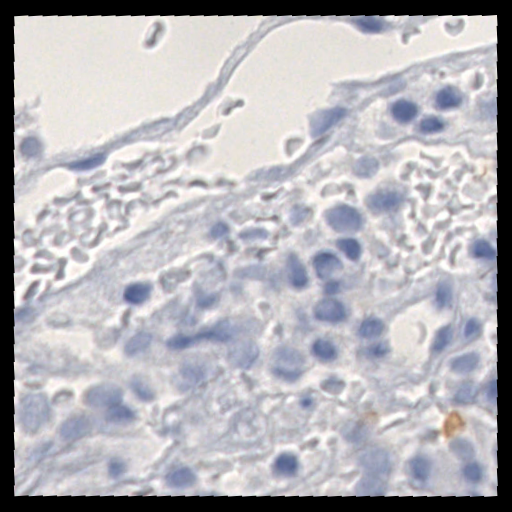

In [94]:
blend_tile

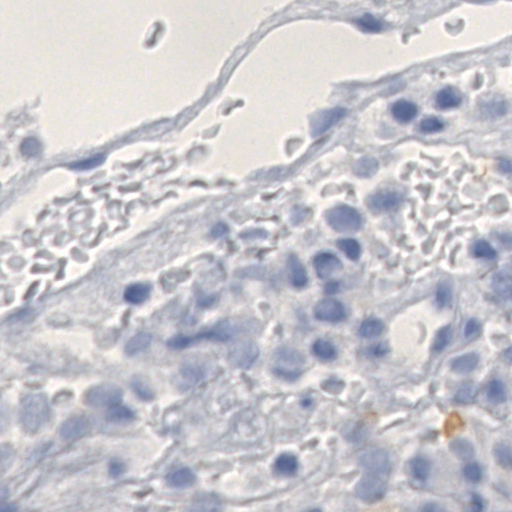

In [95]:
get_tfmd_tile(ihc_slide, 7, 0, (x*16, y*16), (512,512), aff_tfm, bsp_tfm)

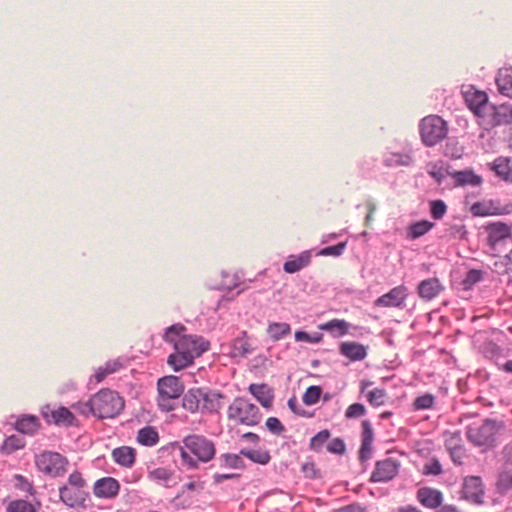

In [96]:
he_slide.read_region((x*16, y*16), 0, (512, 512))

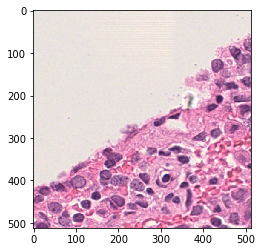

In [97]:
plt.imshow(he_slide.read_region((x*16, y*16), 0, (512, 512)))
plt.savefig(str(index)+"_he_tile_plot.png", dpi=300)

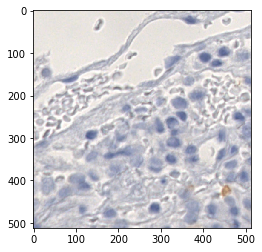

In [98]:
plt.imshow(get_tfmd_tile(ihc_slide, 7, 0, (x*16, y*16), (512,512), aff_tfm, bsp_tfm))
plt.savefig(str(index)+"_ihc_tile_plot_borderless.png", dpi=300)

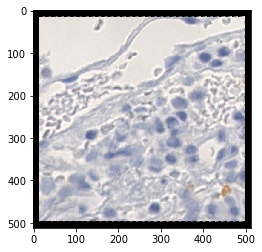

In [99]:
plt.imshow(blend_tile)
plt.savefig(str(index)+"_ihc_tile_plot_border.png", dpi=300)